# **Выбор модели для предсказаний**

In [2]:
import matplotlib.pyplot as plt
import pandas as pd
import os
import pickle
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow as tf
from livelossplot.tf_keras import PlotLossesCallback
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.models import load_model
import time
import numpy as np
from PIL import Image
import tensorflow_addons as tfa

2023-06-05 02:24:24.194282: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/home/michael2/TFODCourse/tfod/lib/python3.8/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


**При необходимости устанавливаем livelossplot и tensorflow-addons.**

In [ ]:
# !pip install livelossplot
# !pip install tensorflow-addons

**Если работаем в google colab, то подключаем google-диск и переходим в папку с проектом. Также colab нужен для проверки времени инференса модели, которое не должно превышать 0.33 сек**

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')
# %cd /content/drive/MyDrive/Скиллбокс/Нейронные сети/Дипломная работа

Mounted at /content/drive
/content/drive/MyDrive/Скиллбокс/Нейронные сети/Дипломная работа


**Считываем файл train.csv  и загружаем его в датафрейм df**

In [ ]:
df = pd.read_csv('train.csv', index_col = 0)
df.head()

,image_path,emotion
0,./train/anger/0.jpg,anger
1,./train/anger/1.jpg,anger
2,./train/anger/10.jpg,anger
3,./train/anger/100.jpg,anger
4,./train/anger/1000.jpg,anger


**Заменим разделители в путях к файлам фотографий на применимые в текущей системе**

In [ ]:
df['image_path'] = df['image_path'].apply(lambda x: os.path.join(*x.split(sep = '/')))

**Разделим датасет на тренировочный и валидационный в пропорции 80%/20%**

In [ ]:
train_df = df.groupby('emotion', group_keys= False).apply(lambda x: x. sample (frac = 0.8, random_state=17))
val_df = df.drop(train_df.index)

**Скачиваем папку с фотографиями для проверки качества прогнозирования модели на kaggle и создаём датафрейм с путями к данным фото**

In [ ]:
photos_list = []
for i in range(5000):
    photos_list.append(os.path.join('.', 'test_kaggle', str(i) + '.jpg'))
test_df = pd.DataFrame(photos_list, columns = ['image_path'])
test_df.head()

,image_path
0,./test_kaggle/0.jpg
1,./test_kaggle/1.jpg
2,./test_kaggle/2.jpg
3,./test_kaggle/3.jpg
4,./test_kaggle/4.jpg


**Пропишем функции, которые нам понадобятся в дальнейшем и создадим словарь, где ключи - это индексы номера эмоции в прогнозе модели, а значения - соответствующее название эмоции**

In [ ]:
names = {0: "anger", 1: "contempt", 2: "disgust", 3: "fear",
             4: "happy", 5: "neutral", 6: "sad", 7: "surprise", 8: "uncertain"}

**Данная функция создает генератор батчей для обучения модели. Так как мы будем тестить разные модели, у которых разные требования к предобработке фотографий перед подачей на вход, то для универсализации данной функции введём ряд аргументов со значениями по умолчанию.**

**1. generator_type - указываем, для чего мы создаем генератор - для тренировки ('train') или для валидации ('val')**

**2. df - передаём датафрейм с данными**

**3. img_size - передаём размер стороны фотографии в пикселях, к которому она будет  приводиться**

**4. batch_size - передаём размер батча. Этот параметр перед обучением сети ставим побольше и смотрим - если выскакивает ошибка о нехватке памяти, то постепенно уменьшаем (кратно восьми) этот параметр, пока "железо" не позволит это обучение начать.**

**5. resc (по умолчанию None) - параметр нормализации значений пикселей фотографии. Если модель позволяет на вход её функции предобработки фотографий подавать ненормализованное изображение, ничего не указываем. Если модель требует предварительно нормализовать значения пикселей от 0 до 1, то указываем 1./255. В каждом случае смотрим документацию по соответствующей модели и читаем описание, что она ожидает на входе.**

**6. prep (по умолчанию None) - указывается, если модель имеет отдельную встроенную функцию предобработки изображений**

**7. mode (по умолчанию 'sparse') - важный параметр, указывающий, каким образом ImageDataGenerator будет кодировать метки классов. 'sparse' - в виде целых чисел, 'categorical' - в виде one hot encoded, 'raw' - не кодируется, передаются числа как есть в сыром виде, для предсказания непрерывных данных.**

**Вначале я использовал метод кодирования 'sparse', но потом, чтобы лучше понимать качество обученной модели, учитывать не только точность, но и полноту предсказаний, я ввёл ещё одну метрику для мониторинга качества - f1 score. Данная метрика требует в качестве меток классов one-hot encoding, поэтому я перешел на метод кодирования 'categorical'**

In [ ]:
def make_data_generator(generator_type, df, img_size, batch_size, resc = None, prep = None, mode = 'sparse'):
    if generator_type == 'train':
        train_generator = ImageDataGenerator(rescale=resc,
                                     preprocessing_function=prep,
                                     rotation_range=45,
                                     horizontal_flip=True,
                                     width_shift_range=0.2,
                                     height_shift_range=0.2,
                                     shear_range=0.2,
                                     zoom_range=0.2,
                                     channel_shift_range=50,
                                     fill_mode='nearest',
                                     brightness_range=[0.2,1.5])
        data_gen = train_generator.flow_from_dataframe(dataframe=df,
                                                     x_col='image_path',
                                                     y_col='emotion',
                                                     target_size=(img_size, img_size),
                                                     batch_size=batch_size,
                                                     class_mode=mode,
                                                     shuffle=True)
    if generator_type == 'val':
        val_generator = ImageDataGenerator(rescale=resc,
                                          preprocessing_function=prep)
        data_gen = val_generator.flow_from_dataframe(dataframe=df,
                                                 x_col='image_path',
                                                 y_col='emotion',
                                                 target_size=(img_size, img_size),
                                                 batch_size=batch_size,
                                                 class_mode=mode,
                                                 shuffle=False)
    return data_gen

**Функция для отрисовки фотграфий с подписанной реальной эмоцией, и в случае передачи аргумента predicted_labels - также будет указана предсказанная эмоция. Если предсказанная эмоция не будет совпадать с реальной - надпись будет окрашена красным цветом.**

In [ ]:
def show_faces(images, labels, predicted_labels=None):
    names = {0: "anger", 1: "contempt", 2: "disgust", 3: "fear",
             4: "happy", 5: "neutral", 6: "sad", 7: "surprise", 8: "uncertain"}
    plt.figure(figsize=(10,10))
    for i in range(16):
        plt.subplot(4,4, i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.imshow(images[i], cmap=plt.cm.gray)
        if predicted_labels is not None:
            title_obj = plt.title(f"Real: {names[labels[i]]}.\nPred: {names[predicted_labels[i]]}")
            if labels[i] != predicted_labels[i]:
                plt.setp(title_obj, color='r')
        else:
            plt.title(f"Real label: {names[labels[i]]}")
    plt.tight_layout()

**Функция для вычисления времени инференса. На вход подаётся тестируемая модель, образец фотографии и количество итераций. Соответственно этому количеству модель проводит инференс тестовой фотографии и время этого инференса записывается в словарь inference_times. Далее вычисляется среднее и медианное время.**

In [ ]:
def benchmark_model(model, sample, iterations=200):
    model.predict(sample)
    inference_times = []
    for i in range(iterations):
        start = time.time()
        model.predict(sample)
        inference_times.append(time.time() - start)
    mean_time = np.mean(inference_times)
    median_time = np.median(inference_times)
    return inference_times, mean_time, median_time

**Функция берет 16 рандомных фото из переданного в качестве аргумента датафрейма, для каждого отрисовывает график его времени инференса, повторённого iteration раз. Затем средние и медианные значения времени инференса для каждой фотографии записываются в словари, которые и подаются на выход функции.**

In [ ]:
def show_inference_time_plots(model, iterations, df, img_size, norm = False):
    absolut_mean_times, absolut_median_times = [], []
    plt.figure(figsize=(16,16))
    for i, path in enumerate(df.sample(16)['image_path']):
        test_img = Image.open(path)
        test_img = test_img.resize((img_size, img_size))
        test_img = np.array(test_img.getdata()).reshape(test_img.size[0], test_img.size[1], 3)
        if norm:
            test_img = test_img / 255
        inference_times, mean_time, median_time = benchmark_model(model, test_img[np.newaxis, ...], iterations);
        plt.subplot(4,4, i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        plt.plot(inference_times)
        plt.title(f'{iterations} iterations\nmean time = {mean_time:.3f}\nmedian time = {median_time:.3f}')
        plt.xlabel('Iteration number')
        plt.ylabel('Inference time, sec')
        absolut_mean_times.append(mean_time)
        absolut_median_times.append(median_time)
    plt.tight_layout()
    return absolut_mean_times, absolut_median_times

**Функция предсказывает эмоцию для одной фотграфии, расположенной по пути path. Эта функция нужна для формирования csv файла тестового предсказания для отправки на kaggle**

In [ ]:
def one_emotion_predict(model, path, img_size, norm = False):
    test_img = Image.open(path)
    test_img = test_img.resize((img_size, img_size))
    test_img = np.array(test_img.getdata()).reshape(test_img.size[0], test_img.size[1], 3)
    if norm:
        test_img = test_img / 255
    test_img = test_img[np.newaxis, ...]
    print(path)
    return np.argmax(model.predict(test_img))

**Функция для нормализации фотографии от 0 до 1. Нужна для подачи в функцию отрисовки show_faces в случае, когда ImageDataGenerator выдает ненормализованный батч**

In [ ]:
def normalize_0_1(batch):
    for i in range(16):
        batch[i] = (batch[i] - batch[i].min())/(batch[i].max() - batch[i].min())
    return batch[:16]

# Самописная нейронная сеть

**Для начала определимся, до какого размера мы будем ресайзить исходное фото. Уменьшение разрешения не ведет к потере даных картинки. Тогда как увеличение размерности приводит к искусственному созданию "лишних" пикселей. Давайте создадим список из размерностей всех фотографий исходного датасета.**

In [ ]:
# emotions_list = [('anger', 7022), ('contempt', 3085), ('disgust', 3155), ('fear', 5044),
#                  ('happy', 5955), ('neutral', 6795), ('sad', 6740), ('surprise', 6323), ('uncertain', 5927)]
# shape_list = []
# for emotion in emotions_list:
#     for i in range(emotion[1]):
#         image = plt.imread(os.path.join(os.getcwd(), 'train', emotion[0], str(i) + '.jpg'))
#         shape_list.append(image.shape)

**Чтобы каждый раз не создавать список заново, сохраним его во внешнем файле.**

In [ ]:
# with open("shape_list.txt", "wb") as myFile:
#     pickle.dump(shape_list, myFile)
with open("shape_list.txt", "rb") as myFile:
    shape_list = pickle.load(myFile)

**Создадим датафрейм на основе полученного списка.**

In [ ]:
shape_df = pd.DataFrame(shape_list, columns = ['width', 'height', 'channels'])
shape_df.head()

,width,height,channels
0,183,183,3
1,749,749,3
2,575,575,3
3,370,370,3
4,188,188,3


**Давайте примем, что 5% от всех фото мы будем ресайзить, увеличивая разрешение. Остальные - уменьшая.**

In [ ]:
photos_df = shape_df.groupby(['width', 'height']).count().cumsum().rename(columns = {'channels': 'photo_count'})
photos_df[photos_df.photo_count > 50046 * 0.05]

,,photo_count
width,height,
179,179,2649
180,180,2694
181,181,2743
182,182,2984
183,183,3267
...,...,...
3849,3849,50042
3893,3893,50043
3919,3919,50044


**Получаем минимальный размер стороны фотографии, удодвлетворяющий нашему условию - 179. Так как GPU удобнее работать с размерностями, кратными восьми, примем нужный нам размер чуть больше - 184 (делится на восемь).**

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 184
N_CLASSES = 9

**Изначально мониторилась только метрика categorical_accuracy, поэтому при создании генераторов фотографий я прописал в функции создания генераторов make_data_generator по умолчанию mode = 'sparse', который требует кодирования меток классов целыми числами (0, 1, 2 и тд).**

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE, resc = 1./255)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE, resc = 1./255)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


**Но затем для лучшего контроля не только точности, но и полноты, я добавил метрику f1_score. Она требует только one-hot кодирования классов. Поэтому я переделал генераторы и передал в функцию в качестве аргумента mode = 'categorical', что и означает one-hot кодирование.**

In [ ]:
# train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE, resc = 1./255, mode = 'categorical')
# val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE, resc = 1./255, mode = 'categorical')

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
train_data_gen.class_indices

{'anger': 0,
 'contempt': 1,
 'disgust': 2,
 'fear': 3,
 'happy': 4,
 'neutral': 5,
 'sad': 6,
 'surprise': 7,
 'uncertain': 8}

**Посмотрим на ряд случайных фото из тренировочного датасета. Можно увидеть, что фото прошли через аугментацию, которую мы прописали при создании функции make_data_generator**

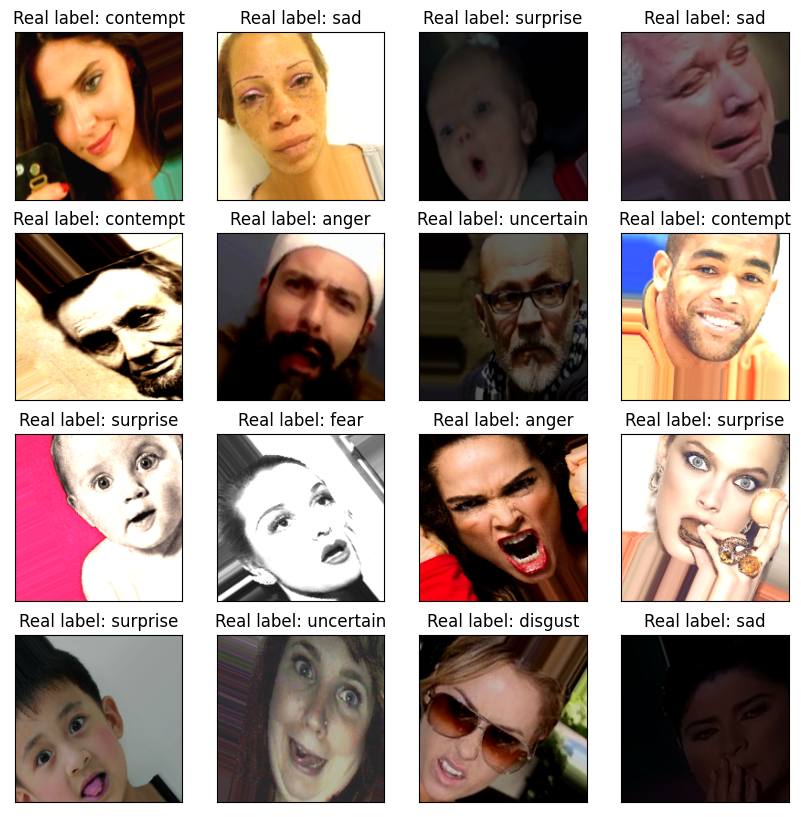

In [ ]:
sample_training_images, sample_labels = next(train_data_gen)
show_faces(sample_training_images, sample_labels)

**Создадим нашу сеть из чередования слоев конволюции и макс пулинга. Далее понизим размерность до 1D тензора через слой GlobalAveragePooling2D и применим полносвязные слои с выходом на 9 нейронов по числу классов и активацией softmax.**

In [ ]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(64, (3,3), activation='relu', input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)),
    tf.keras.layers.MaxPooling2D(2, 2),
    
    tf.keras.layers.Conv2D(128, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Conv2D(256, (3,3), activation='relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    
    tf.keras.layers.Conv2D(256, (3,3), activation='relu'),
    
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Conv2D(256, (1,1), activation='relu'),
    
    tf.keras.layers.GlobalAveragePooling2D(),
    tf.keras.layers.Dense(256, activation='relu'),
    tf.keras.layers.Dropout(0.1),
    tf.keras.layers.Dense(9, activation='softmax')
])

2023-04-19 08:04:28.515330: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-19 08:04:29.079625: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5714 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


**Посмотрим архитектуру сети. Видим, что при обучении используется около 1 миллиона параметров.**

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 182, 182, 64)      1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 91, 91, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 89, 89, 128)       73856     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 44, 44, 128)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 42, 42, 256)       295168    
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 21, 21, 256)      0

**Скомпилируем нашу модель. Применим переменный коэффициент скорости обучения для более тонкой настройки.**

In [ ]:
# lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate=5e-4,
#     decay_steps=100,
#     decay_rate=0.9)
# checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'simple_model_f1', '{epoch:02d}_checkpoint_{val_categorical_accuracy:.3f}'),
#                              monitor = 'val_categorical_accuracy',
#                              verbose=1,
#                              save_best_only=True,
#                              save_freq='epoch',
#                              mode='max')
# es = EarlyStopping(monitor='val_categorical_accuracy', mode='max', verbose=1, patience=10)
# model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
#               optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
#               metrics=[tf.keras.metrics.CategoricalAccuracy(),
#                       tfa.metrics.F1Score(num_classes = 9, average = 'macro', dtype=tf.float32)])

In [ ]:
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=100,
    decay_rate=0.9)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'simple_model', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])


**Обучим нашу модель, сохраняя лучшую по точности модель в папке CPT под именем simple_model или simple_model_f1 при обучении с применением дополниельной метрики f1_score**

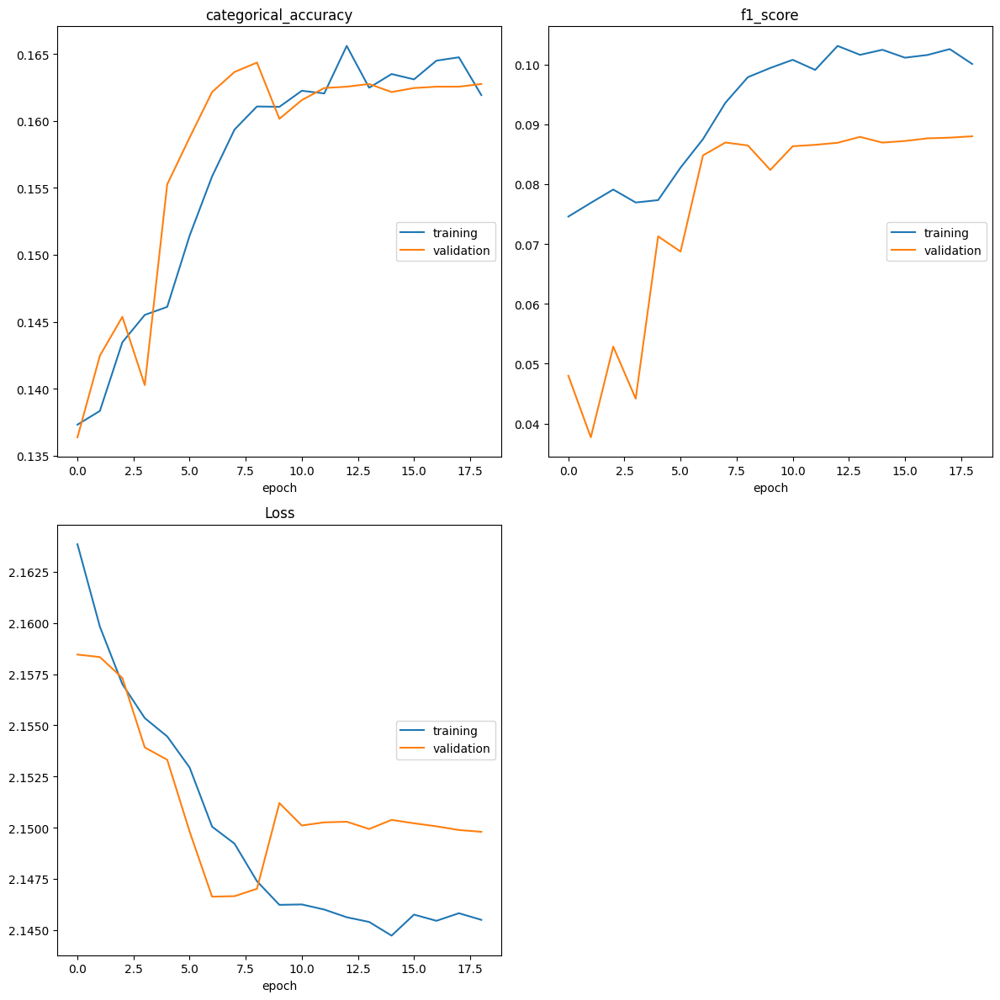

categorical_accuracy
	training         	 (min:    0.137, max:    0.166, cur:    0.162)
	validation       	 (min:    0.136, max:    0.164, cur:    0.163)
f1_score
	training         	 (min:    0.075, max:    0.103, cur:    0.100)
	validation       	 (min:    0.038, max:    0.088, cur:    0.088)
Loss
	training         	 (min:    2.145, max:    2.164, cur:    2.145)
	validation       	 (min:    2.147, max:    2.158, cur:    2.150)
385/385 [==============================] - 271s 704ms/step - loss: 2.1455 - categorical_accuracy: 0.1619 - f1_score: 0.1001 - val_loss: 2.1498 - val_categorical_accuracy: 0.1628 - val_f1_score: 0.0880
Epoch 19: early stopping


In [ ]:
# EPOCHS = 50
# history = model.fit(
#     train_data_gen,
#     epochs=EPOCHS,
#     validation_data=val_data_gen,
#     callbacks=[es, checkpoint, PlotLossesCallback()])

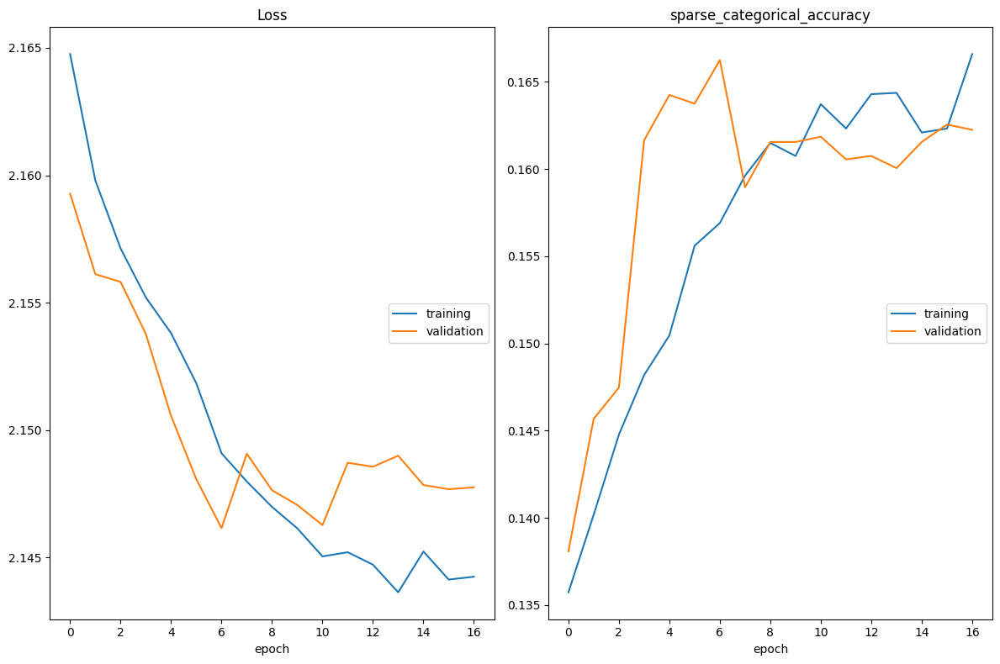

Loss
	training         	 (min:    2.144, max:    2.165, cur:    2.144)
	validation       	 (min:    2.146, max:    2.159, cur:    2.148)
sparse_categorical_accuracy
	training         	 (min:    0.136, max:    0.167, cur:    0.167)
	validation       	 (min:    0.138, max:    0.166, cur:    0.162)
385/385 [==============================] - 267s 694ms/step - loss: 2.1442 - sparse_categorical_accuracy: 0.1666 - val_loss: 2.1478 - val_sparse_categorical_accuracy: 0.1623
Epoch 17: early stopping


In [ ]:
EPOCHS = 50
history = model.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

**В дальнейшем будем просто загружать модель с лучшими параметрами**

In [ ]:
model = load_model(os.path.join(os.getcwd(),'CPT', 'simple_model', '07_checkpoint_0.166'))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 182, 182, 64)      1792      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 91, 91, 64)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 89, 89, 128)       73856     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 44, 44, 128)      0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 42, 42, 256)       295168    
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 21, 21, 256)      0

**Проведем инференс модели на валидационном датасете. Получаем точность 16.63% - очень низкую.**

In [ ]:
loss, acc = model.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 18s - loss: 2.1461 - sparse_categorical_accuracy: 0.1663 - 18s/epoch - 189ms/step
Restored model, accuracy: 16.63%


**Посмотрим, как модель в реальности прогнозирует эмоции на случайном сэмпле из валидации. Как мы видим, ошибок много.**

4/4 [==============================] - 0s 48ms/step


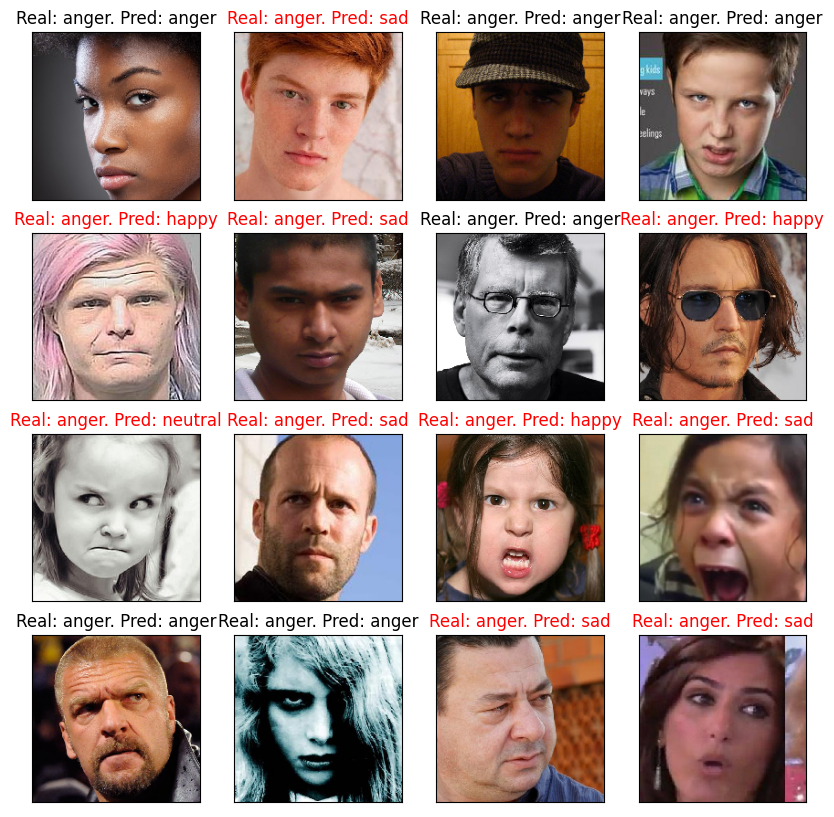

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(model.predict(sample_val_images), axis=1))

**Следующую ячейку запускаем в google colab для вычисления средего времени инференса одной картинки.**

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(model, ITER, test_df, IMAGE_SIZE, norm = True)

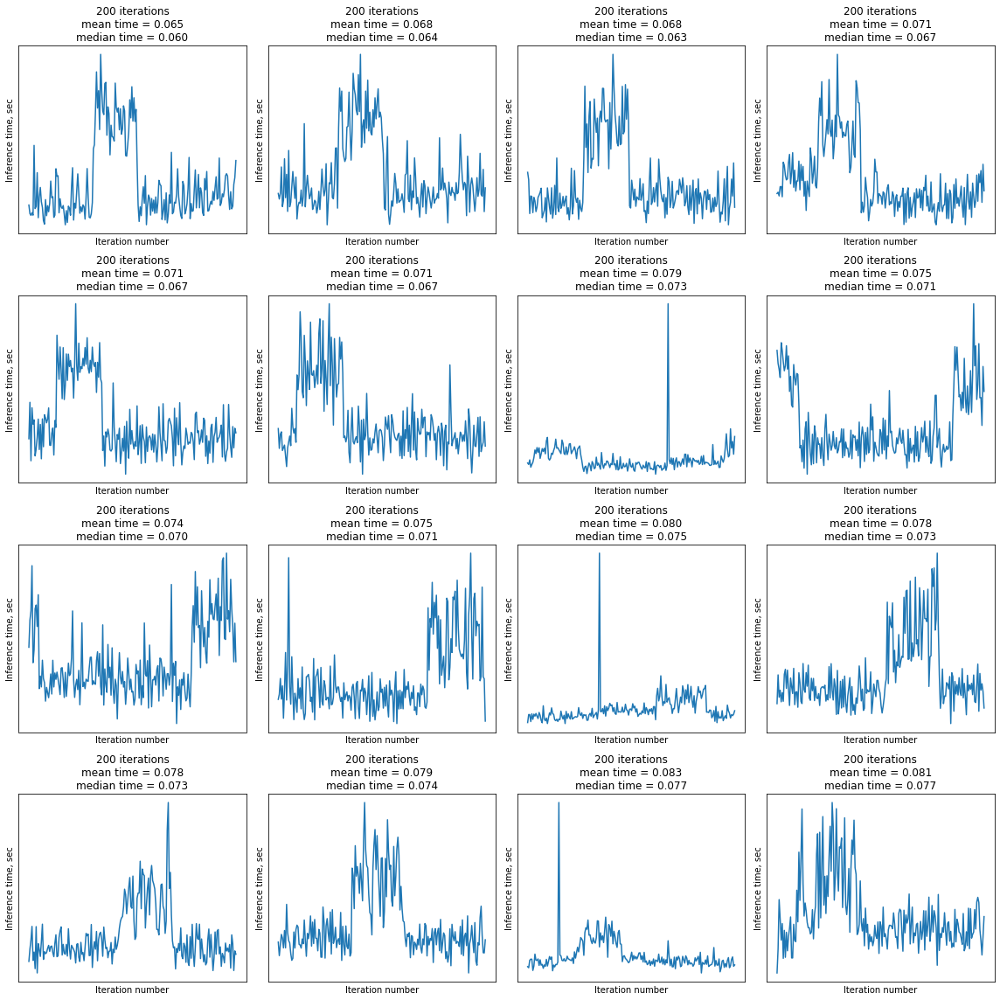

**Получаем среднее время 0.072 сек и медианное время 0.067 сек. Берем большее - 0.072 сек. Но дальше это значительно меньше 0.33 сек, то есть по времент инференса модель нам подходит.**

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.07166598476469516 0.06687567383050919


**Формируем датафрейм для отсылки на kaggle.**

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(model, x, IMAGE_SIZE, norm = True))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])


In [ ]:
answer_df.head()

,image_path,emotion
0,0.jpg,anger
1,1.jpg,happy
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,neutral


**Переводим датафрейм в csv файл и отправляем на kaggle.**

In [ ]:
answer_df.to_csv('answer1.csv', index = False)

**Получаем оценку на private kaggle 0.1736**

# Transfer Learning ConvNeXtXLarge

**Используем одну из готовых моделей, обученную на датасете ImageNet-21k. "Родная" размерность фотографий на входе сети 224 х 224.**

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 224
N_CLASSES = 9

**Опять же изначально использовалась только одна метрика для контроля качества обучения сети, но впоследствии я добавил f1_score.**

In [ ]:
# train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE, mode = 'categorical')
# val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE, mode = 'categorical')

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


**Данная сеть включает в себя функцию препроцессинга фото. Произведем transfer learning этой модели. Уберем верхушку - полносвязные слои, а остальные заморозим.**

In [ ]:
base_model = tf.keras.applications.convnext.ConvNeXtXLarge(
    model_name='convnext_xlarge',
    include_top=False,
    include_preprocessing=True,
    input_shape = (IMAGE_SIZE, IMAGE_SIZE, 3),
    classifier_activation=None
)
base_model.trainable = False

2023-04-12 21:06:34.538848: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-12 21:06:35.109912: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5758 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


In [ ]:
base_model.summary()

Model: "convnext_xlarge"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 convnext_xlarge_prestem_normal  (None, 224, 224, 3)  0          ['input_1[0][0]']                
 ization (Normalization)                                                                          
                                                                                                  
 convnext_xlarge_stem (Sequenti  (None, 56, 56, 256)  13056      ['convnext_xlarge_prestem_normali
 al)                                                             zation[0][0]']     

 convnext_xlarge_stage_0_block_  (None, 56, 56, 256)  0          ['convnext_xlarge_stage_0_block_2
 2_identity (Activation)                                         _layer_scale[0][0]']             
                                                                                                  
 tf.__operators__.add_2 (TFOpLa  (None, 56, 56, 256)  0          ['tf.__operators__.add_1[0][0]', 
 mbda)                                                            'convnext_xlarge_stage_0_block_2
                                                                 _identity[0][0]']                
                                                                                                  
 convnext_xlarge_downsampling_b  (None, 28, 28, 512)  525312     ['tf.__operators__.add_2[0][0]'] 
 lock_0 (Sequential)                                                                              
                                                                                                  
 convnext_

 2_identity (Activation)                                         _layer_scale[0][0]']             
                                                                                                  
 tf.__operators__.add_5 (TFOpLa  (None, 28, 28, 512)  0          ['tf.__operators__.add_4[0][0]', 
 mbda)                                                            'convnext_xlarge_stage_1_block_2
                                                                 _identity[0][0]']                
                                                                                                  
 convnext_xlarge_downsampling_b  (None, 14, 14, 1024  2099200    ['tf.__operators__.add_5[0][0]'] 
 lock_1 (Sequential)            )                                                                 
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  51200      ['convnext_xlarge_downsampling_bl
 0_depthwi

                                                                                                  
 tf.__operators__.add_8 (TFOpLa  (None, 14, 14, 1024  0          ['tf.__operators__.add_7[0][0]', 
 mbda)                          )                                 'convnext_xlarge_stage_2_block_2
                                                                 _identity[0][0]']                
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  51200      ['tf.__operators__.add_8[0][0]'] 
 3_depthwise_conv (Conv2D)      )                                                                 
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  2048       ['convnext_xlarge_stage_2_block_3
 3_layernorm (LayerNormalizatio  )                               _depthwise_conv[0][0]']          
 n)       

 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  51200      ['tf.__operators__.add_11[0][0]']
 6_depthwise_conv (Conv2D)      )                                                                 
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  2048       ['convnext_xlarge_stage_2_block_6
 6_layernorm (LayerNormalizatio  )                               _depthwise_conv[0][0]']          
 n)                                                                                               
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  4198400    ['convnext_xlarge_stage_2_block_6
 6_pointwise_conv_1 (Dense)     )                                _layernorm[0][0]']               
                                                                                                  
 convnext_

 n)                                                                                               
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  4198400    ['convnext_xlarge_stage_2_block_9
 9_pointwise_conv_1 (Dense)     )                                _layernorm[0][0]']               
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  0          ['convnext_xlarge_stage_2_block_9
 9_gelu (Activation)            )                                _pointwise_conv_1[0][0]']        
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  4195328    ['convnext_xlarge_stage_2_block_9
 9_pointwise_conv_2 (Dense)     )                                _gelu[0][0]']                    
          

 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  0          ['convnext_xlarge_stage_2_block_1
 12_gelu (Activation)           )                                2_pointwise_conv_1[0][0]']       
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  4195328    ['convnext_xlarge_stage_2_block_1
 12_pointwise_conv_2 (Dense)    )                                2_gelu[0][0]']                   
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  1024       ['convnext_xlarge_stage_2_block_1
 12_layer_scale (LayerScale)    )                                2_pointwise_conv_2[0][0]']       
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  0          ['convnext_xlarge_stage_2_block_1
 12_identi

                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  1024       ['convnext_xlarge_stage_2_block_1
 15_layer_scale (LayerScale)    )                                5_pointwise_conv_2[0][0]']       
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  0          ['convnext_xlarge_stage_2_block_1
 15_identity (Activation)       )                                5_layer_scale[0][0]']            
                                                                                                  
 tf.__operators__.add_21 (TFOpL  (None, 14, 14, 1024  0          ['tf.__operators__.add_20[0][0]',
 ambda)                         )                                 'convnext_xlarge_stage_2_block_1
                                                                 5_identity[0][0]']               
          

 18_identity (Activation)       )                                8_layer_scale[0][0]']            
                                                                                                  
 tf.__operators__.add_24 (TFOpL  (None, 14, 14, 1024  0          ['tf.__operators__.add_23[0][0]',
 ambda)                         )                                 'convnext_xlarge_stage_2_block_1
                                                                 8_identity[0][0]']               
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  51200      ['tf.__operators__.add_24[0][0]']
 19_depthwise_conv (Conv2D)     )                                                                 
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  2048       ['convnext_xlarge_stage_2_block_1
 19_layern

                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  51200      ['tf.__operators__.add_27[0][0]']
 22_depthwise_conv (Conv2D)     )                                                                 
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  2048       ['convnext_xlarge_stage_2_block_2
 22_layernorm (LayerNormalizati  )                               2_depthwise_conv[0][0]']         
 on)                                                                                              
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  4198400    ['convnext_xlarge_stage_2_block_2
 22_pointwise_conv_1 (Dense)    )                                2_layernorm[0][0]']              
          

 25_layernorm (LayerNormalizati  )                               5_depthwise_conv[0][0]']         
 on)                                                                                              
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  4198400    ['convnext_xlarge_stage_2_block_2
 25_pointwise_conv_1 (Dense)    )                                5_layernorm[0][0]']              
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 4096  0          ['convnext_xlarge_stage_2_block_2
 25_gelu (Activation)           )                                5_pointwise_conv_1[0][0]']       
                                                                                                  
 convnext_xlarge_stage_2_block_  (None, 14, 14, 1024  4195328    ['convnext_xlarge_stage_2_block_2
 25_pointw

 n)                                                                                               
                                                                                                  
 convnext_xlarge_stage_3_block_  (None, 7, 7, 8192)  16785408    ['convnext_xlarge_stage_3_block_1
 1_pointwise_conv_1 (Dense)                                      _layernorm[0][0]']               
                                                                                                  
 convnext_xlarge_stage_3_block_  (None, 7, 7, 8192)  0           ['convnext_xlarge_stage_3_block_1
 1_gelu (Activation)                                             _pointwise_conv_1[0][0]']        
                                                                                                  
 convnext_xlarge_stage_3_block_  (None, 7, 7, 2048)  16779264    ['convnext_xlarge_stage_3_block_1
 1_pointwise_conv_2 (Dense)                                      _gelu[0][0]']                    
          

In [ ]:
# transf_learn_model = tf.keras.Sequential([
#   base_model,
#   tf.keras.layers.GlobalAveragePooling2D(),
#   tf.keras.layers.Dense(512, activation='relu'),
#   tf.keras.layers.Dropout(0.1),
#   tf.keras.layers.Dense(N_CLASSES, activation='softmax')
# ])

# lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
#     initial_learning_rate=5e-4,
#     decay_steps=100,
#     decay_rate=0.9)
# checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model_f1', '{epoch:02d}_checkpoint_{val_categorical_accuracy:.3f}'),
#                              monitor = 'val_categorical_accuracy',
#                              verbose=1,
#                              save_best_only=True,
#                              save_freq='epoch',
#                              mode='max')
# es = EarlyStopping(monitor='val_categorical_accuracy', mode='max', verbose=1, patience=10)
# transf_learn_model.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
#               optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
#               metrics=[tf.keras.metrics.CategoricalAccuracy(),
#                       tfa.metrics.F1Score(num_classes = 9, average = 'macro', dtype=tf.float32)])

In [ ]:
transf_learn_model = tf.keras.Sequential([
  base_model,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=100,
    decay_rate=0.9)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
transf_learn_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

In [ ]:
transf_learn_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 convnext_xlarge (Functional  (None, 7, 7, 2048)       348147968 
 )                                                               
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               1049088   
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 349,201,673
Trainable params: 1,053,705
No

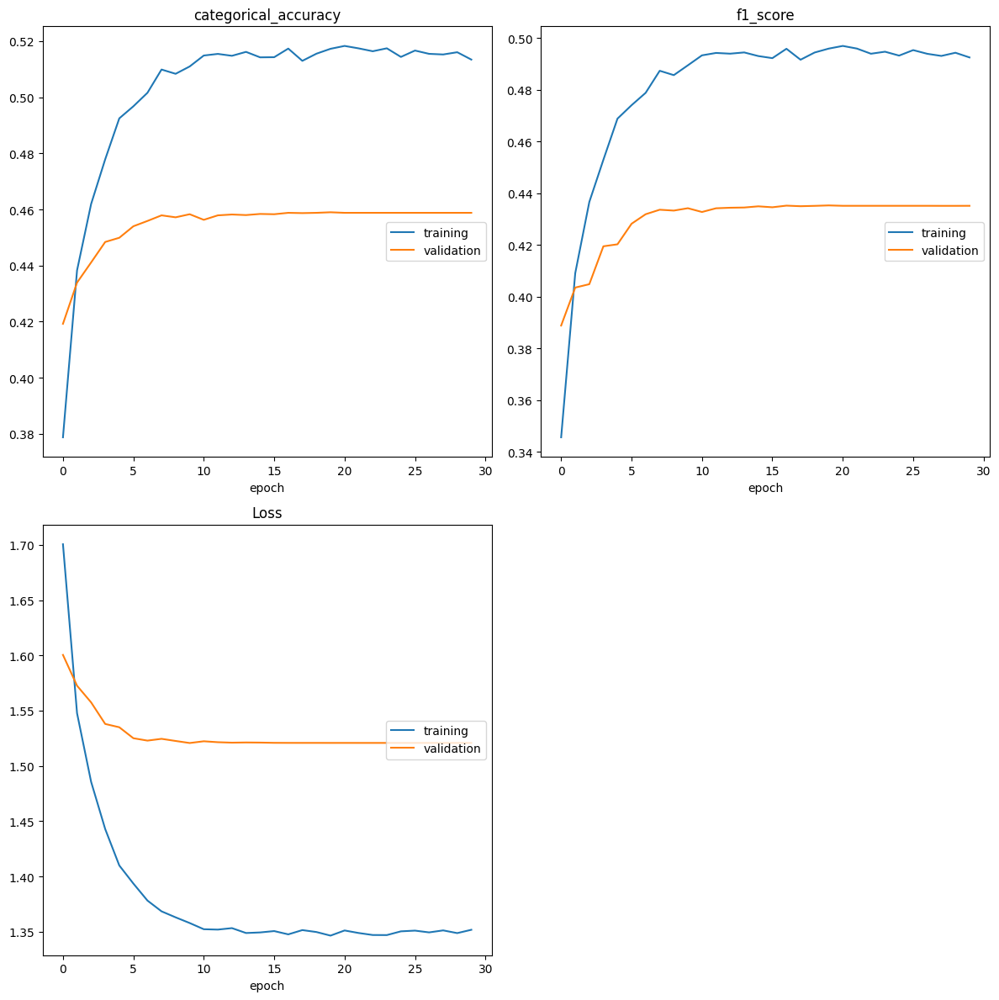

categorical_accuracy
	training         	 (min:    0.379, max:    0.518, cur:    0.513)
	validation       	 (min:    0.419, max:    0.459, cur:    0.459)
f1_score
	training         	 (min:    0.346, max:    0.497, cur:    0.493)
	validation       	 (min:    0.389, max:    0.435, cur:    0.435)
Loss
	training         	 (min:    1.346, max:    1.701, cur:    1.352)
	validation       	 (min:    1.521, max:    1.600, cur:    1.521)
385/385 [==============================] - 862s 2s/step - loss: 1.3518 - categorical_accuracy: 0.5134 - f1_score: 0.4926 - val_loss: 1.5208 - val_categorical_accuracy: 0.4588 - val_f1_score: 0.4352
Epoch 30: early stopping


In [ ]:
# EPOCHS = 50
# history = transf_learn_model.fit(
#     train_data_gen,
#     epochs=EPOCHS,
#     validation_data=val_data_gen,
#     callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
EPOCHS = 50
history = transf_learn_model.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

Epoch 1/50


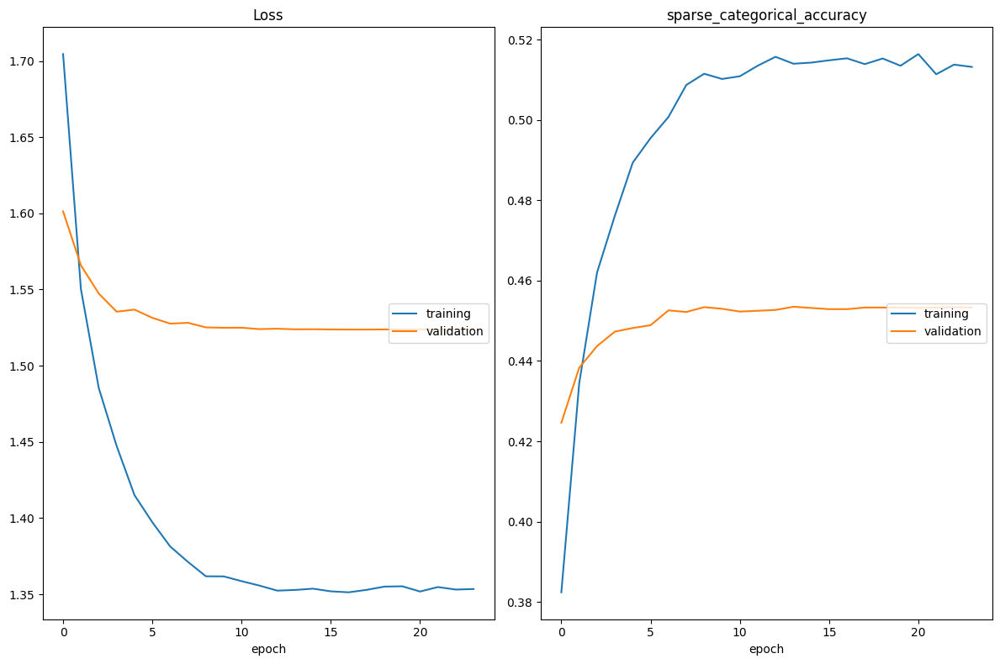

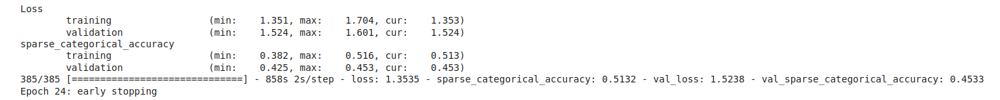

**В дальнейшем будем использовать модель, обученную без применения дополнительной метрики f1_score,так как на само обучение дополнительная метрика не влияет. Она нужна тоько для лучшего понимания, что модель не только точна, но и обладает достаточной полнотой. Просто все модели я обучил, не применяя f1_score. И проводить все обучения заново займёт очень много времени без в принципе изменения конечного результата. Поэтому в дальнейшем f1 не используется . Почему именно здесь я ее применил. Просто на тот момент все модели уже были обучены и я уже знал, что это лучшая.**

In [ ]:
transf_learn_model = load_model(os.path.join(os.getcwd(),'CPT', 'transf_learn_model', '14_checkpoint_0.453'))

2023-03-22 19:48:20.332276: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-22 19:48:20.763896: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5757 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(transf_learn_model, ITER, test_df, IMAGE_SIZE)

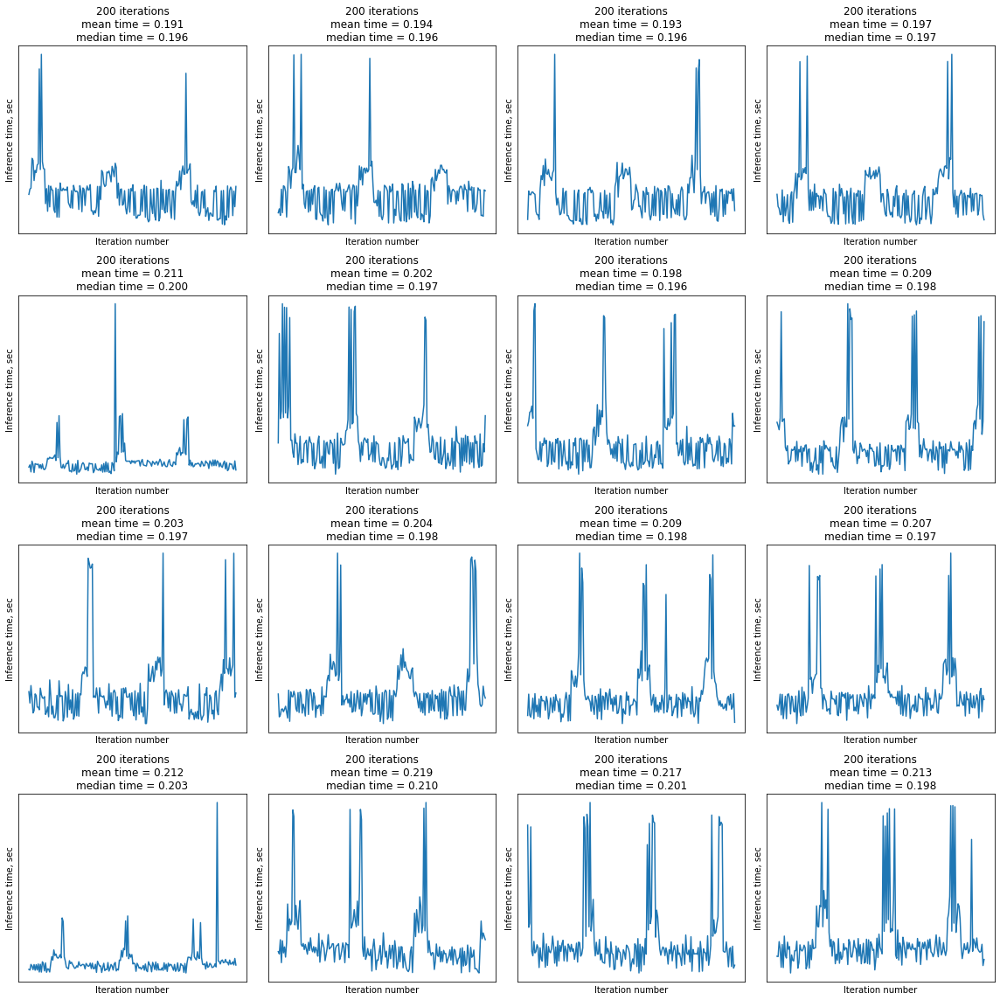

**Модель "тяжелая", поэтому время инференса немалое. Но оно все равно почти в 2 раза меньше критического. Модель подходит.**

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.20495600454509258 0.1985313594341278


**Точность 45.33%**

In [ ]:
loss, acc = transf_learn_model.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 171s - loss: 1.5238 - sparse_categorical_accuracy: 0.4533 - 171s/epoch - 2s/step
Restored model, accuracy: 45.33%


4/4 [==============================] - 2s 452ms/step


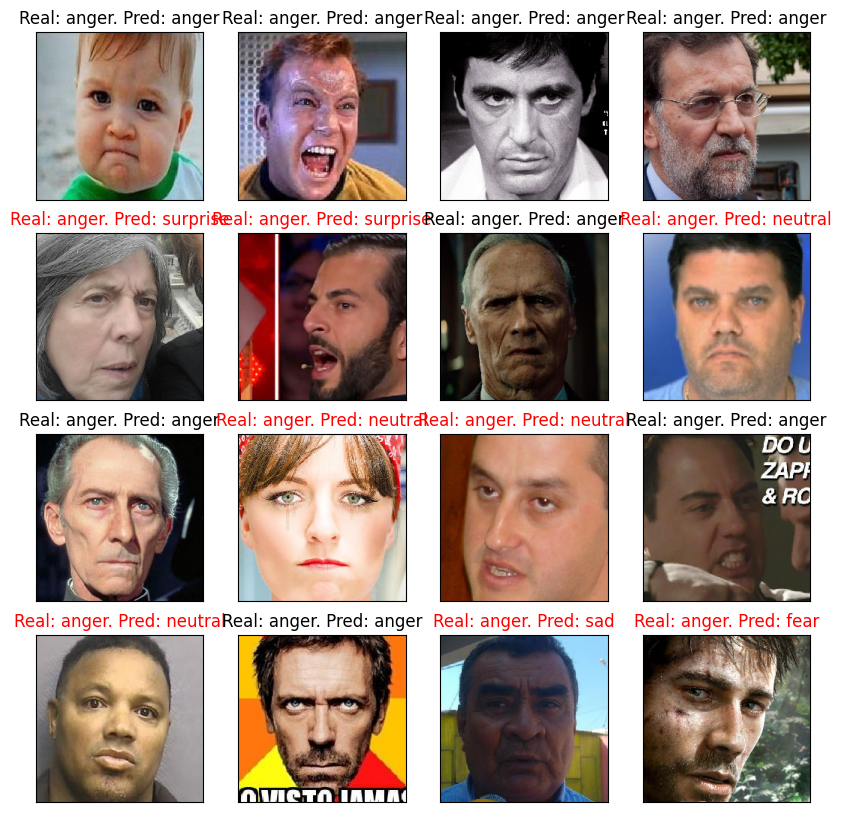

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(transf_learn_model.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,neutral
2,2.jpg,neutral
3,3.jpg,anger
4,4.jpg,contempt
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,fear
4997,4997.jpg,neutral
4998,4998.jpg,neutral


In [ ]:
answer_df.to_csv('answer2.csv', index = False)

**На private kaggle получаем 0.4508. Это является проходной точностью, обусловленной заданием (> 0.4)** 

# Fine Tuning ConvNeXtXLarge

**Произведем fine tuning модели. Разморозим несколько последних слоев и переобучим их.**

In [ ]:
base_model.trainable = True
print("Количество слоев в базовой модели: ", len(base_model.layers))

Количество слоев в базовой модели:  295


In [ ]:
fine_tune_at = 288
for layer in base_model.layers[:fine_tune_at]:
    layer.trainable =  False

In [ ]:
for i in range(fine_tune_at - 4, len(base_model.layers)):
    print(f'Слой {base_model.layers[i].name}, trainable = {base_model.layers[i].trainable}')

Слой convnext_xlarge_stage_3_block_1_identity, trainable = False
Слой tf.__operators__.add_34, trainable = False
Слой convnext_xlarge_stage_3_block_2_depthwise_conv, trainable = False
Слой convnext_xlarge_stage_3_block_2_layernorm, trainable = False
Слой convnext_xlarge_stage_3_block_2_pointwise_conv_1, trainable = True
Слой convnext_xlarge_stage_3_block_2_gelu, trainable = True
Слой convnext_xlarge_stage_3_block_2_pointwise_conv_2, trainable = True
Слой convnext_xlarge_stage_3_block_2_layer_scale, trainable = True
Слой convnext_xlarge_stage_3_block_2_identity, trainable = True
Слой tf.__operators__.add_35, trainable = True
Слой layer_normalization, trainable = True


In [ ]:
fine_tune_model = tf.keras.Sequential([
  base_model,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

In [ ]:
fine_tune_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 convnext_xlarge (Functional  (None, 7, 7, 2048)       348147968 
 )                                                               
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               1049088   
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 349,201,673
Trainable params: 34,624,521
N

In [ ]:
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-5,
    decay_steps=100,
    decay_rate=0.98)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'fine_tune_model', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
fine_tune_model.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

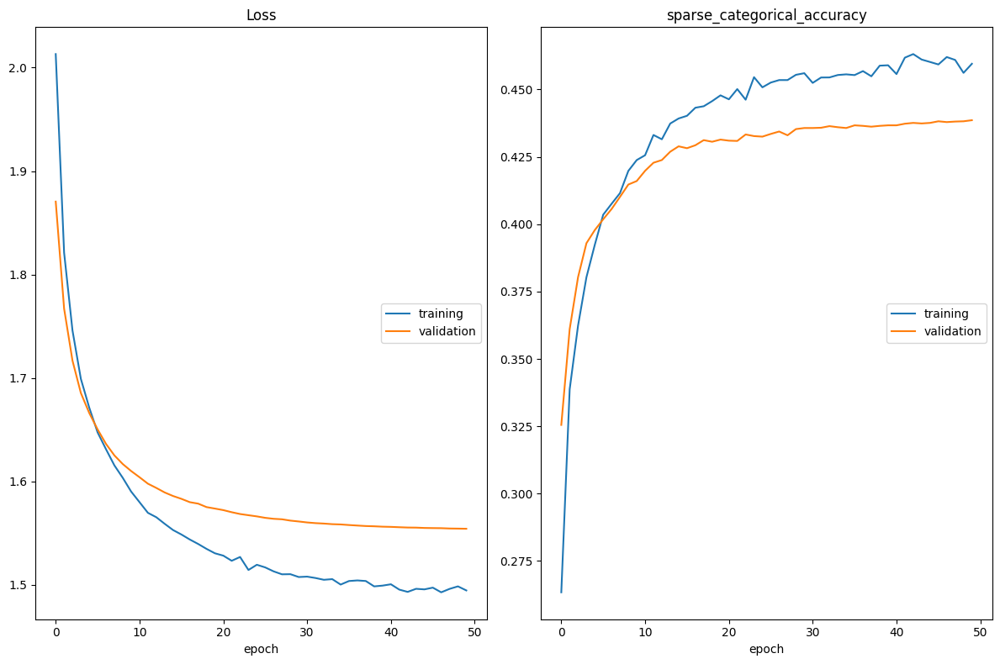

Loss
	training         	 (min:    1.493, max:    2.013, cur:    1.495)
	validation       	 (min:    1.554, max:    1.871, cur:    1.554)
sparse_categorical_accuracy
	training         	 (min:    0.263, max:    0.463, cur:    0.460)
	validation       	 (min:    0.326, max:    0.439, cur:    0.439)
385/385 [==============================] - 902s 2s/step - loss: 1.4946 - sparse_categorical_accuracy: 0.4595 - val_loss: 1.5542 - val_sparse_categorical_accuracy: 0.4386


In [ ]:
EPOCHS = 50
history = fine_tune_model.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

**Сеть стала менее склонной к переобучению, но при этом потеряла в обобщающей способности.**

In [ ]:
fine_tune_model = load_model(os.path.join(os.getcwd(),'CPT', 'fine_tune_model', '50_checkpoint_0.439'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(fine_tune_model, ITER, test_df, IMAGE_SIZE)

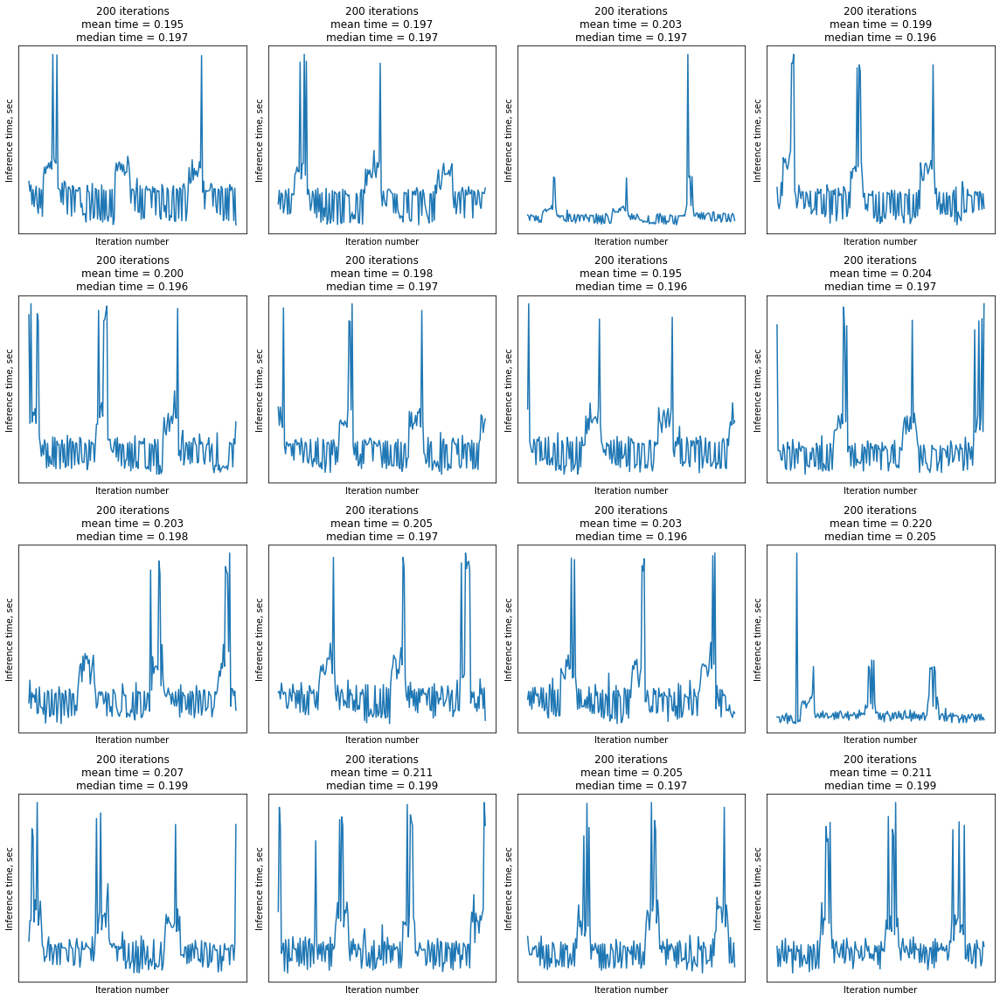

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.20342017523944378 0.19756107032299042


In [ ]:
loss, acc = fine_tune_model.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 171s - loss: 1.5542 - sparse_categorical_accuracy: 0.4386 - 171s/epoch - 2s/step
Restored model, accuracy: 43.86%


4/4 [==============================] - 8s 962ms/step


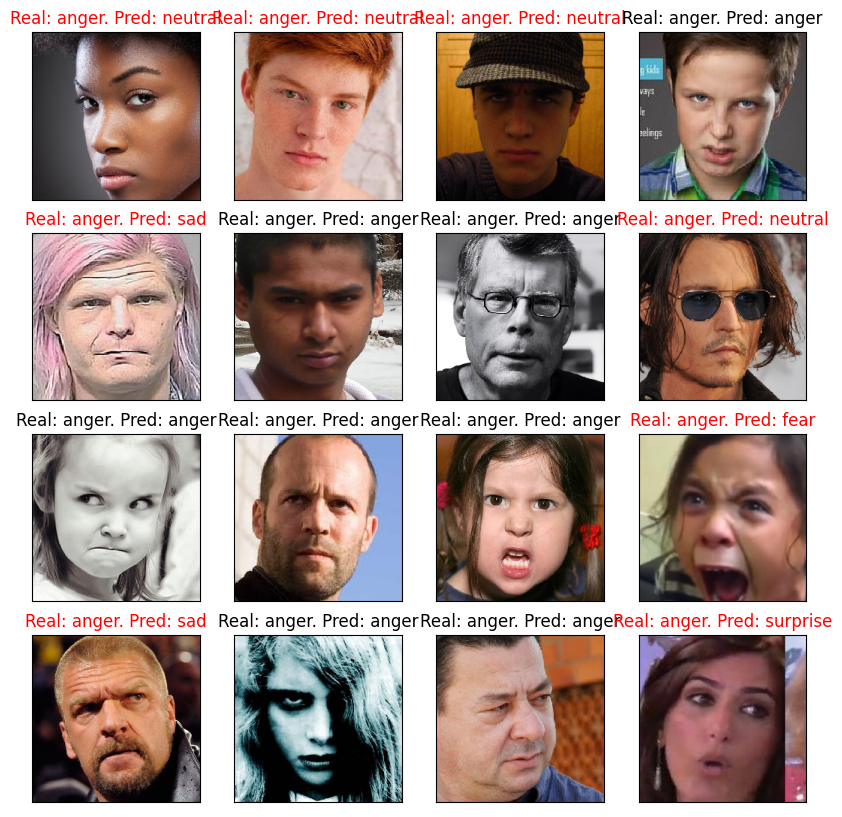

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(fine_tune_model.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(fine_tune_model, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,neutral
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,happy
4998,4998.jpg,sad


In [ ]:
answer_df.to_csv('answer3.csv', index = False)

**На private kaggle получаем 0.4228. Это является проходной точностью, обусловленной заданием (> 0.4)** 

# Transfer Learning Efficient net V2 Long

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 480
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_2 = tf.keras.applications.EfficientNetV2L(
    weights="imagenet",
    include_top=False,
    include_preprocessing=True,
    input_shape = (IMAGE_SIZE, IMAGE_SIZE, 3),
    classifier_activation=None
)
base_model_2.trainable = False

2023-03-24 21:30:37.357876: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-24 21:30:37.900707: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5719 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


In [ ]:
base_model_2.summary()

Model: "efficientnetv2-l"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 480, 480, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_1 (Rescaling)        (None, 480, 480, 3)  0           ['input_2[0][0]']                
                                                                                                  
 stem_conv (Conv2D)             (None, 240, 240, 32  864         ['rescaling_1[0][0]']            
                                )                                                                 
                                                                                   

                                                                                                  
 block2a_project_conv (Conv2D)  (None, 120, 120, 64  8192        ['block2a_expand_activation[0][0]
                                )                                ']                               
                                                                                                  
 block2a_project_bn (BatchNorma  (None, 120, 120, 64  256        ['block2a_project_conv[0][0]']   
 lization)                      )                                                                 
                                                                                                  
 block2b_expand_conv (Conv2D)   (None, 120, 120, 25  147456      ['block2a_project_bn[0][0]']     
                                6)                                                                
                                                                                                  
 block2b_e

 lization)                      )                                                                 
                                                                                                  
 block2e_drop (Dropout)         (None, 120, 120, 64  0           ['block2e_project_bn[0][0]']     
                                )                                                                 
                                                                                                  
 block2e_add (Add)              (None, 120, 120, 64  0           ['block2e_drop[0][0]',           
                                )                                 'block2d_add[0][0]']            
                                                                                                  
 block2f_expand_conv (Conv2D)   (None, 120, 120, 25  147456      ['block2e_add[0][0]']            
                                6)                                                                
          

 block3c_expand_conv (Conv2D)   (None, 60, 60, 384)  331776      ['block3b_add[0][0]']            
                                                                                                  
 block3c_expand_bn (BatchNormal  (None, 60, 60, 384)  1536       ['block3c_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block3c_expand_activation (Act  (None, 60, 60, 384)  0          ['block3c_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block3c_project_conv (Conv2D)  (None, 60, 60, 96)   36864       ['block3c_expand_activation[0][0]
                                                                 ']                               
          

                                                                                                  
 block3g_project_conv (Conv2D)  (None, 60, 60, 96)   36864       ['block3g_expand_activation[0][0]
                                                                 ']                               
                                                                                                  
 block3g_project_bn (BatchNorma  (None, 60, 60, 96)  384         ['block3g_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block3g_drop (Dropout)         (None, 60, 60, 96)   0           ['block3g_project_bn[0][0]']     
                                                                                                  
 block3g_add (Add)              (None, 60, 60, 96)   0           ['block3g_drop[0][0]',           
          

                                                                  'block4a_project_bn[0][0]']     
                                                                                                  
 block4c_expand_conv (Conv2D)   (None, 30, 30, 768)  147456      ['block4b_add[0][0]']            
                                                                                                  
 block4c_expand_bn (BatchNormal  (None, 30, 30, 768)  3072       ['block4c_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block4c_expand_activation (Act  (None, 30, 30, 768)  0          ['block4c_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block4c_d

 ization)                                                                                         
                                                                                                  
 block4e_expand_activation (Act  (None, 30, 30, 768)  0          ['block4e_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block4e_dwconv2 (DepthwiseConv  (None, 30, 30, 768)  6912       ['block4e_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block4e_bn (BatchNormalization  (None, 30, 30, 768)  3072       ['block4e_dwconv2[0][0]']        
 )                                                                                                
          

 block4g_dwconv2 (DepthwiseConv  (None, 30, 30, 768)  6912       ['block4g_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block4g_bn (BatchNormalization  (None, 30, 30, 768)  3072       ['block4g_dwconv2[0][0]']        
 )                                                                                                
                                                                                                  
 block4g_activation (Activation  (None, 30, 30, 768)  0          ['block4g_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block4g_se_squeeze (GlobalAver  (None, 768)         0           ['block4g_activation[0][0]']     
 agePoolin

                                                                                                  
 block4i_activation (Activation  (None, 30, 30, 768)  0          ['block4i_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block4i_se_squeeze (GlobalAver  (None, 768)         0           ['block4i_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block4i_se_reshape (Reshape)   (None, 1, 1, 768)    0           ['block4i_se_squeeze[0][0]']     
                                                                                                  
 block4i_se_reduce (Conv2D)     (None, 1, 1, 48)     36912       ['block4i_se_reshape[0][0]']     
          

 block5a_se_squeeze (GlobalAver  (None, 1152)        0           ['block5a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block5a_se_reshape (Reshape)   (None, 1, 1, 1152)   0           ['block5a_se_squeeze[0][0]']     
                                                                                                  
 block5a_se_reduce (Conv2D)     (None, 1, 1, 48)     55344       ['block5a_se_reshape[0][0]']     
                                                                                                  
 block5a_se_expand (Conv2D)     (None, 1, 1, 1152)   56448       ['block5a_se_reduce[0][0]']      
                                                                                                  
 block5a_se_excite (Multiply)   (None, 30, 30, 1152  0           ['block5a_activation[0][0]',     
          

                                                                                                  
 block5c_se_excite (Multiply)   (None, 30, 30, 1344  0           ['block5c_activation[0][0]',     
                                )                                 'block5c_se_expand[0][0]']      
                                                                                                  
 block5c_project_conv (Conv2D)  (None, 30, 30, 224)  301056      ['block5c_se_excite[0][0]']      
                                                                                                  
 block5c_project_bn (BatchNorma  (None, 30, 30, 224)  896        ['block5c_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5c_drop (Dropout)         (None, 30, 30, 224)  0           ['block5c_project_bn[0][0]']     
          

                                                                                                  
 block5e_project_conv (Conv2D)  (None, 30, 30, 224)  301056      ['block5e_se_excite[0][0]']      
                                                                                                  
 block5e_project_bn (BatchNorma  (None, 30, 30, 224)  896        ['block5e_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5e_drop (Dropout)         (None, 30, 30, 224)  0           ['block5e_project_bn[0][0]']     
                                                                                                  
 block5e_add (Add)              (None, 30, 30, 224)  0           ['block5e_drop[0][0]',           
                                                                  'block5d_add[0][0]']            
          

 block5g_project_bn (BatchNorma  (None, 30, 30, 224)  896        ['block5g_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5g_drop (Dropout)         (None, 30, 30, 224)  0           ['block5g_project_bn[0][0]']     
                                                                                                  
 block5g_add (Add)              (None, 30, 30, 224)  0           ['block5g_drop[0][0]',           
                                                                  'block5f_add[0][0]']            
                                                                                                  
 block5h_expand_conv (Conv2D)   (None, 30, 30, 1344  301056      ['block5g_add[0][0]']            
                                )                                                                 
          

 block5i_drop (Dropout)         (None, 30, 30, 224)  0           ['block5i_project_bn[0][0]']     
                                                                                                  
 block5i_add (Add)              (None, 30, 30, 224)  0           ['block5i_drop[0][0]',           
                                                                  'block5h_add[0][0]']            
                                                                                                  
 block5j_expand_conv (Conv2D)   (None, 30, 30, 1344  301056      ['block5i_add[0][0]']            
                                )                                                                 
                                                                                                  
 block5j_expand_bn (BatchNormal  (None, 30, 30, 1344  5376       ['block5j_expand_conv[0][0]']    
 ization)                       )                                                                 
          

                                                                  'block5j_add[0][0]']            
                                                                                                  
 block5l_expand_conv (Conv2D)   (None, 30, 30, 1344  301056      ['block5k_add[0][0]']            
                                )                                                                 
                                                                                                  
 block5l_expand_bn (BatchNormal  (None, 30, 30, 1344  5376       ['block5l_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block5l_expand_activation (Act  (None, 30, 30, 1344  0          ['block5l_expand_bn[0][0]']      
 ivation)                       )                                                                 
          

                                )                                                                 
                                                                                                  
 block5n_expand_bn (BatchNormal  (None, 30, 30, 1344  5376       ['block5n_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block5n_expand_activation (Act  (None, 30, 30, 1344  0          ['block5n_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block5n_dwconv2 (DepthwiseConv  (None, 30, 30, 1344  12096      ['block5n_expand_activation[0][0]
 2D)                            )                                ']                               
          

 ization)                       )                                                                 
                                                                                                  
 block5p_expand_activation (Act  (None, 30, 30, 1344  0          ['block5p_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block5p_dwconv2 (DepthwiseConv  (None, 30, 30, 1344  12096      ['block5p_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block5p_bn (BatchNormalization  (None, 30, 30, 1344  5376       ['block5p_dwconv2[0][0]']        
 )                              )                                                                 
          

 ivation)                       )                                                                 
                                                                                                  
 block5r_dwconv2 (DepthwiseConv  (None, 30, 30, 1344  12096      ['block5r_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block5r_bn (BatchNormalization  (None, 30, 30, 1344  5376       ['block5r_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block5r_activation (Activation  (None, 30, 30, 1344  0          ['block5r_bn[0][0]']             
 )                              )                                                                 
          

 2D)                            )                                ']                               
                                                                                                  
 block6a_bn (BatchNormalization  (None, 15, 15, 1344  5376       ['block6a_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block6a_activation (Activation  (None, 15, 15, 1344  0          ['block6a_bn[0][0]']             
 )                              )                                                                 
                                                                                                  
 block6a_se_squeeze (GlobalAver  (None, 1344)        0           ['block6a_activation[0][0]']     
 agePooling2D)                                                                                    
          

 block6c_se_squeeze (GlobalAver  (None, 2304)        0           ['block6c_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block6c_se_reshape (Reshape)   (None, 1, 1, 2304)   0           ['block6c_se_squeeze[0][0]']     
                                                                                                  
 block6c_se_reduce (Conv2D)     (None, 1, 1, 96)     221280      ['block6c_se_reshape[0][0]']     
                                                                                                  
 block6c_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block6c_se_reduce[0][0]']      
                                                                                                  
 block6c_se_excite (Multiply)   (None, 15, 15, 2304  0           ['block6c_activation[0][0]',     
          

 block6e_se_reshape (Reshape)   (None, 1, 1, 2304)   0           ['block6e_se_squeeze[0][0]']     
                                                                                                  
 block6e_se_reduce (Conv2D)     (None, 1, 1, 96)     221280      ['block6e_se_reshape[0][0]']     
                                                                                                  
 block6e_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block6e_se_reduce[0][0]']      
                                                                                                  
 block6e_se_excite (Multiply)   (None, 15, 15, 2304  0           ['block6e_activation[0][0]',     
                                )                                 'block6e_se_expand[0][0]']      
                                                                                                  
 block6e_project_conv (Conv2D)  (None, 15, 15, 384)  884736      ['block6e_se_excite[0][0]']      
          

                                                                                                  
 block6g_se_expand (Conv2D)     (None, 1, 1, 2304)   223488      ['block6g_se_reduce[0][0]']      
                                                                                                  
 block6g_se_excite (Multiply)   (None, 15, 15, 2304  0           ['block6g_activation[0][0]',     
                                )                                 'block6g_se_expand[0][0]']      
                                                                                                  
 block6g_project_conv (Conv2D)  (None, 15, 15, 384)  884736      ['block6g_se_excite[0][0]']      
                                                                                                  
 block6g_project_bn (BatchNorma  (None, 15, 15, 384)  1536       ['block6g_project_conv[0][0]']   
 lization)                                                                                        
          

 block6i_se_excite (Multiply)   (None, 15, 15, 2304  0           ['block6i_activation[0][0]',     
                                )                                 'block6i_se_expand[0][0]']      
                                                                                                  
 block6i_project_conv (Conv2D)  (None, 15, 15, 384)  884736      ['block6i_se_excite[0][0]']      
                                                                                                  
 block6i_project_bn (BatchNorma  (None, 15, 15, 384)  1536       ['block6i_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block6i_drop (Dropout)         (None, 15, 15, 384)  0           ['block6i_project_bn[0][0]']     
                                                                                                  
 block6i_a

 block6k_project_conv (Conv2D)  (None, 15, 15, 384)  884736      ['block6k_se_excite[0][0]']      
                                                                                                  
 block6k_project_bn (BatchNorma  (None, 15, 15, 384)  1536       ['block6k_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block6k_drop (Dropout)         (None, 15, 15, 384)  0           ['block6k_project_bn[0][0]']     
                                                                                                  
 block6k_add (Add)              (None, 15, 15, 384)  0           ['block6k_drop[0][0]',           
                                                                  'block6j_add[0][0]']            
                                                                                                  
 block6l_e

 lization)                                                                                        
                                                                                                  
 block6m_drop (Dropout)         (None, 15, 15, 384)  0           ['block6m_project_bn[0][0]']     
                                                                                                  
 block6m_add (Add)              (None, 15, 15, 384)  0           ['block6m_drop[0][0]',           
                                                                  'block6l_add[0][0]']            
                                                                                                  
 block6n_expand_conv (Conv2D)   (None, 15, 15, 2304  884736      ['block6m_add[0][0]']            
                                )                                                                 
                                                                                                  
 block6n_e

                                                                                                  
 block6o_add (Add)              (None, 15, 15, 384)  0           ['block6o_drop[0][0]',           
                                                                  'block6n_add[0][0]']            
                                                                                                  
 block6p_expand_conv (Conv2D)   (None, 15, 15, 2304  884736      ['block6o_add[0][0]']            
                                )                                                                 
                                                                                                  
 block6p_expand_bn (BatchNormal  (None, 15, 15, 2304  9216       ['block6p_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block6p_e

                                                                                                  
 block6r_expand_conv (Conv2D)   (None, 15, 15, 2304  884736      ['block6q_add[0][0]']            
                                )                                                                 
                                                                                                  
 block6r_expand_bn (BatchNormal  (None, 15, 15, 2304  9216       ['block6r_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block6r_expand_activation (Act  (None, 15, 15, 2304  0          ['block6r_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block6r_d

                                                                                                  
 block6t_expand_bn (BatchNormal  (None, 15, 15, 2304  9216       ['block6t_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block6t_expand_activation (Act  (None, 15, 15, 2304  0          ['block6t_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block6t_dwconv2 (DepthwiseConv  (None, 15, 15, 2304  20736      ['block6t_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block6t_b

                                                                                                  
 block6v_expand_activation (Act  (None, 15, 15, 2304  0          ['block6v_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block6v_dwconv2 (DepthwiseConv  (None, 15, 15, 2304  20736      ['block6v_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block6v_bn (BatchNormalization  (None, 15, 15, 2304  9216       ['block6v_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block6v_a

                                                                                                  
 block6x_dwconv2 (DepthwiseConv  (None, 15, 15, 2304  20736      ['block6x_expand_activation[0][0]
 2D)                            )                                ']                               
                                                                                                  
 block6x_bn (BatchNormalization  (None, 15, 15, 2304  9216       ['block6x_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block6x_activation (Activation  (None, 15, 15, 2304  0          ['block6x_bn[0][0]']             
 )                              )                                                                 
                                                                                                  
 block6x_s

                                                                                                  
 block7a_bn (BatchNormalization  (None, 15, 15, 2304  9216       ['block7a_dwconv2[0][0]']        
 )                              )                                                                 
                                                                                                  
 block7a_activation (Activation  (None, 15, 15, 2304  0          ['block7a_bn[0][0]']             
 )                              )                                                                 
                                                                                                  
 block7a_se_squeeze (GlobalAver  (None, 2304)        0           ['block7a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block7a_s

 agePooling2D)                                                                                    
                                                                                                  
 block7c_se_reshape (Reshape)   (None, 1, 1, 3840)   0           ['block7c_se_squeeze[0][0]']     
                                                                                                  
 block7c_se_reduce (Conv2D)     (None, 1, 1, 160)    614560      ['block7c_se_reshape[0][0]']     
                                                                                                  
 block7c_se_expand (Conv2D)     (None, 1, 1, 3840)   618240      ['block7c_se_reduce[0][0]']      
                                                                                                  
 block7c_se_excite (Multiply)   (None, 15, 15, 3840  0           ['block7c_activation[0][0]',     
                                )                                 'block7c_se_expand[0][0]']      
          

                                                                                                  
 block7e_se_reduce (Conv2D)     (None, 1, 1, 160)    614560      ['block7e_se_reshape[0][0]']     
                                                                                                  
 block7e_se_expand (Conv2D)     (None, 1, 1, 3840)   618240      ['block7e_se_reduce[0][0]']      
                                                                                                  
 block7e_se_excite (Multiply)   (None, 15, 15, 3840  0           ['block7e_activation[0][0]',     
                                )                                 'block7e_se_expand[0][0]']      
                                                                                                  
 block7e_project_conv (Conv2D)  (None, 15, 15, 640)  2457600     ['block7e_se_excite[0][0]']      
                                                                                                  
 block7e_p

 block7g_se_expand (Conv2D)     (None, 1, 1, 3840)   618240      ['block7g_se_reduce[0][0]']      
                                                                                                  
 block7g_se_excite (Multiply)   (None, 15, 15, 3840  0           ['block7g_activation[0][0]',     
                                )                                 'block7g_se_expand[0][0]']      
                                                                                                  
 block7g_project_conv (Conv2D)  (None, 15, 15, 640)  2457600     ['block7g_se_excite[0][0]']      
                                                                                                  
 block7g_project_bn (BatchNorma  (None, 15, 15, 640)  2560       ['block7g_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block7g_d

In [ ]:
transf_learn_model_2 = tf.keras.Sequential([
  base_model_2,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=100,
    decay_rate=0.9)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model_2', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
transf_learn_model_2.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

In [ ]:
transf_learn_model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-l (Functiona  (None, 15, 15, 1280)     117746848 
 l)                                                              
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               655872    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 118,407,337
Trainable params: 660,489
Non-

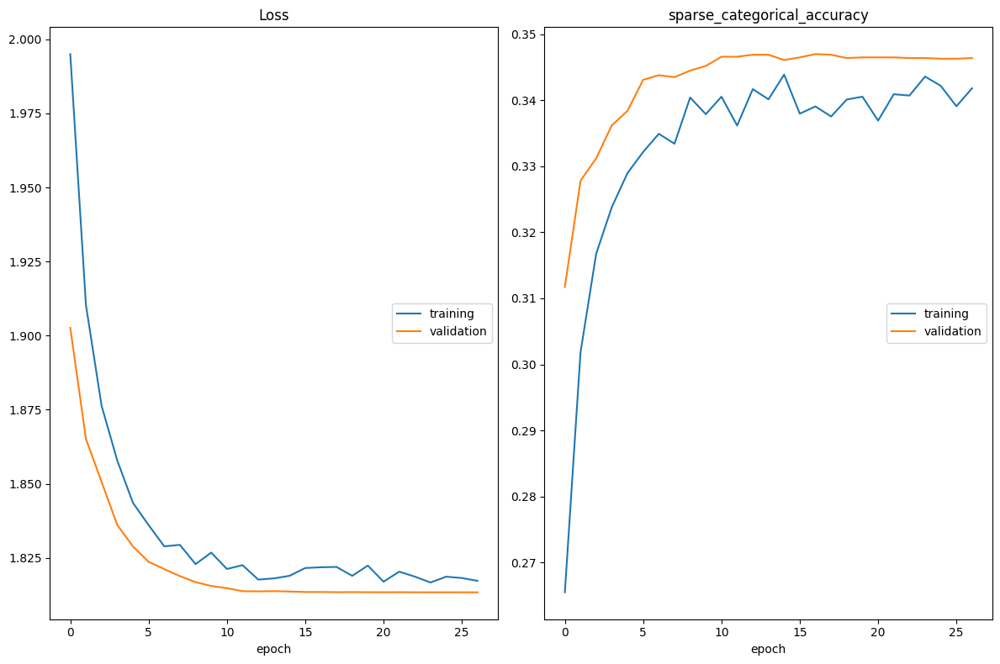

Loss
	training         	 (min:    1.817, max:    1.995, cur:    1.817)
	validation       	 (min:    1.813, max:    1.903, cur:    1.813)
sparse_categorical_accuracy
	training         	 (min:    0.265, max:    0.344, cur:    0.342)
	validation       	 (min:    0.312, max:    0.347, cur:    0.346)
385/385 [==============================] - 1614s 4s/step - loss: 1.8172 - sparse_categorical_accuracy: 0.3418 - val_loss: 1.8134 - val_sparse_categorical_accuracy: 0.3464
Epoch 27: early stopping


In [ ]:
EPOCHS = 50
history = transf_learn_model_2.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
transf_learn_model_2 = load_model(os.path.join(os.getcwd(),'CPT', 'transf_learn_model_2', '17_checkpoint_0.347'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(transf_learn_model_2, ITER, test_df, IMAGE_SIZE)

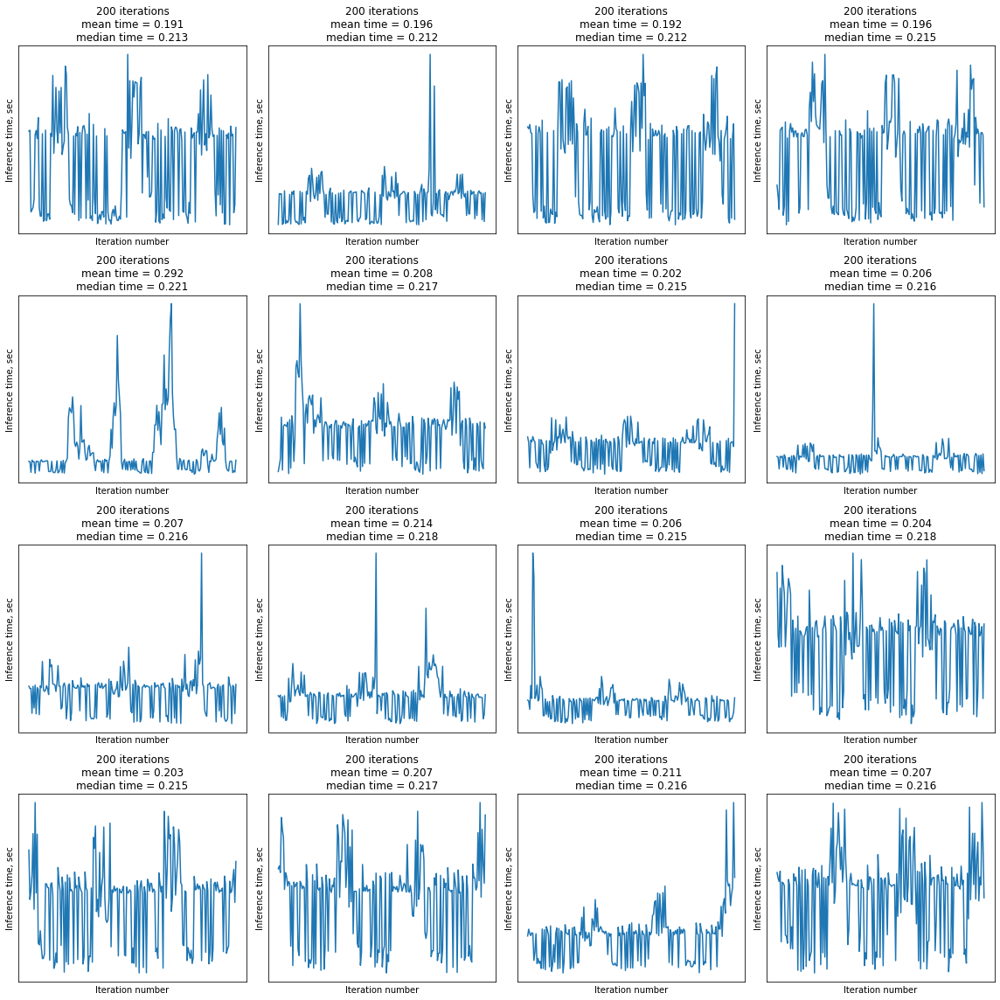

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.192633104249835 0.19625059515237808


In [ ]:
loss, acc = transf_learn_model_2.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 254s - loss: 1.8135 - sparse_categorical_accuracy: 0.3470 - 254s/epoch - 3s/step
Restored model, accuracy: 34.70%


4/4 [==============================] - 11s 874ms/step


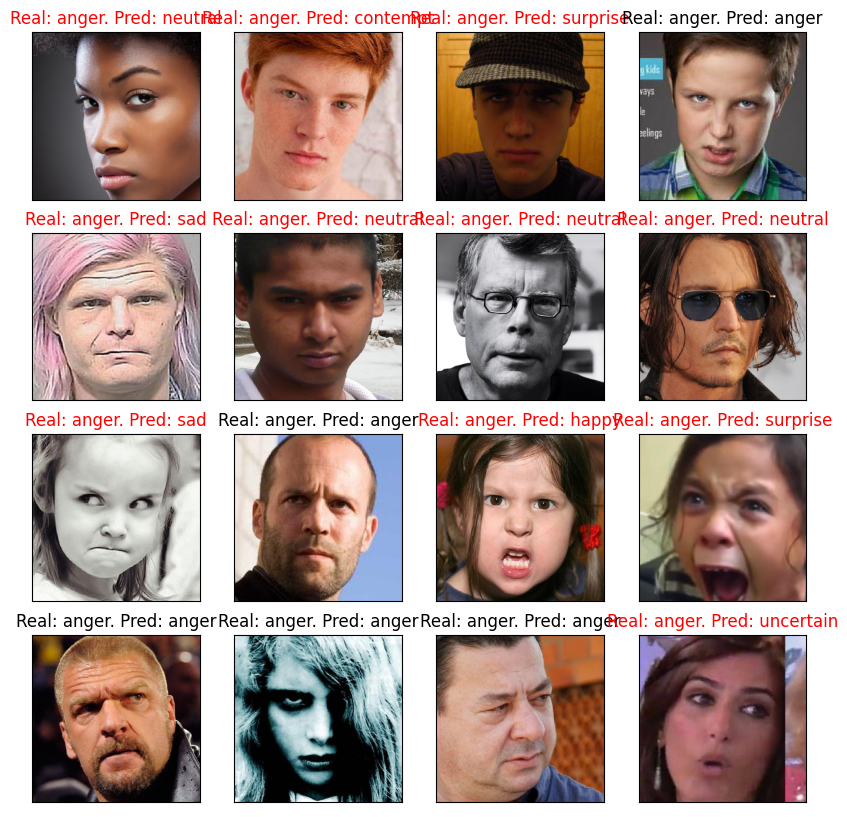

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(transf_learn_model_2.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model_2, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,anger
4,4.jpg,neutral
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,anger
4998,4998.jpg,neutral


In [ ]:
answer_df.to_csv('answer4.csv', index = False)

**0.3456 на private kaggle**

# Fine Tuning Efficient net V2 Long

In [ ]:
BATCH_SIZE = 96
IMAGE_SIZE = 480
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_2.trainable = True
print("Количество слоев в базовой модели: ", len(base_model_2.layers))

Количество слоев в базовой модели:  1028


In [ ]:
fine_tune_at = 1010
for layer in base_model_2.layers[:fine_tune_at]:
    layer.trainable =  False

In [ ]:
for i in range(fine_tune_at - 4, len(base_model_2.layers)):
    print(f'Слой {base_model_2.layers[i].name}, trainable = {base_model_2.layers[i].trainable}')

Слой block7f_project_conv, trainable = False
Слой block7f_project_bn, trainable = False
Слой block7f_drop, trainable = False
Слой block7f_add, trainable = False
Слой block7g_expand_conv, trainable = True
Слой block7g_expand_bn, trainable = True
Слой block7g_expand_activation, trainable = True
Слой block7g_dwconv2, trainable = True
Слой block7g_bn, trainable = True
Слой block7g_activation, trainable = True
Слой block7g_se_squeeze, trainable = True
Слой block7g_se_reshape, trainable = True
Слой block7g_se_reduce, trainable = True
Слой block7g_se_expand, trainable = True
Слой block7g_se_excite, trainable = True
Слой block7g_project_conv, trainable = True
Слой block7g_project_bn, trainable = True
Слой block7g_drop, trainable = True
Слой block7g_add, trainable = True
Слой top_conv, trainable = True
Слой top_bn, trainable = True
Слой top_activation, trainable = True


In [ ]:
fine_tune_model_2 = tf.keras.Sequential([
  base_model_2,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

In [ ]:
fine_tune_model_2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-l (Functiona  (None, 15, 15, 1280)     117746848 
 l)                                                              
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               655872    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 118,407,337
Trainable params: 7,681,449
No

In [ ]:
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-5,
    decay_steps=100,
    decay_rate=0.98)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'fine_tune_model_2', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
fine_tune_model_2.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

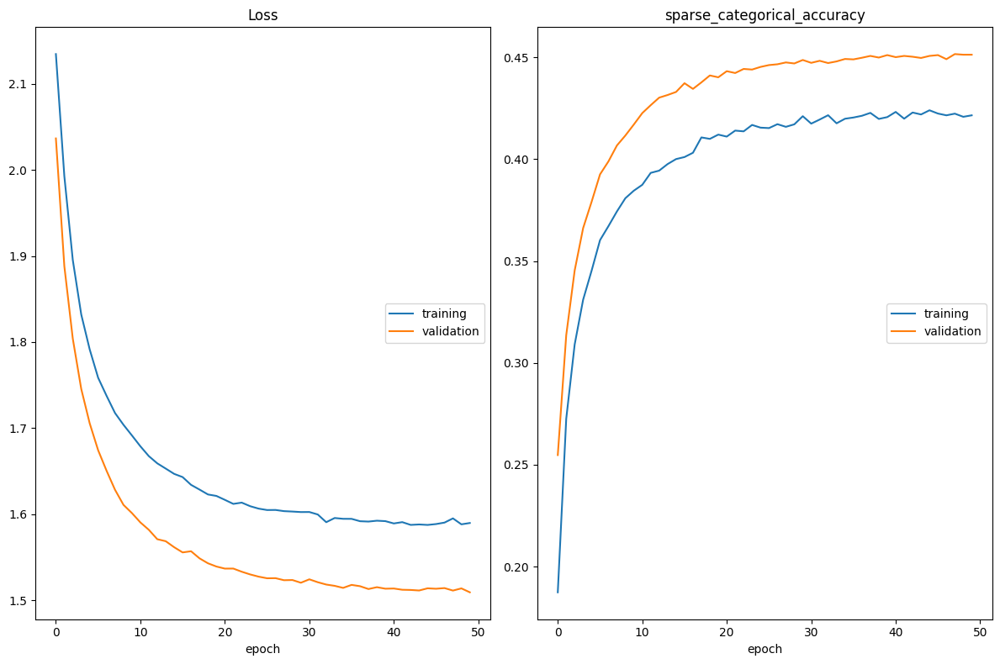

Loss
	training         	 (min:    1.587, max:    2.135, cur:    1.590)
	validation       	 (min:    1.509, max:    2.037, cur:    1.509)
sparse_categorical_accuracy
	training         	 (min:    0.187, max:    0.424, cur:    0.422)
	validation       	 (min:    0.255, max:    0.452, cur:    0.451)
418/418 [==============================] - 1694s 4s/step - loss: 1.5897 - sparse_categorical_accuracy: 0.4215 - val_loss: 1.5091 - val_sparse_categorical_accuracy: 0.4513


In [ ]:
EPOCHS = 50
history = fine_tune_model_2.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
fine_tune_model_2 = load_model(os.path.join(os.getcwd(),'CPT', 'fine_tune_model_2', '48_checkpoint_0.452'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(fine_tune_model_2, ITER, test_df, IMAGE_SIZE)

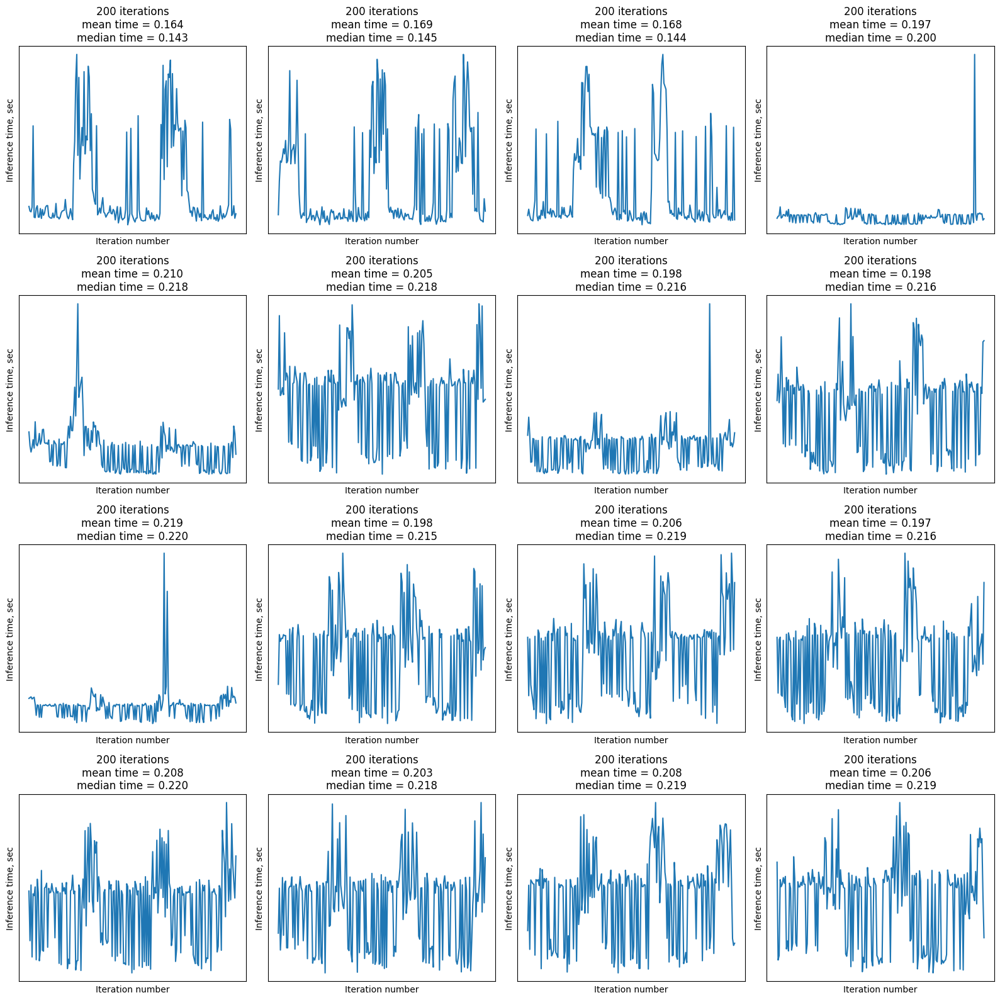

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.19703301571309567 0.20302703231573105


In [ ]:
loss, acc = fine_tune_model_2.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

105/105 - 229s - loss: 1.5091 - sparse_categorical_accuracy: 0.4513 - 229s/epoch - 2s/step
Restored model, accuracy: 45.13%


3/3 [==============================] - 11s 595ms/step


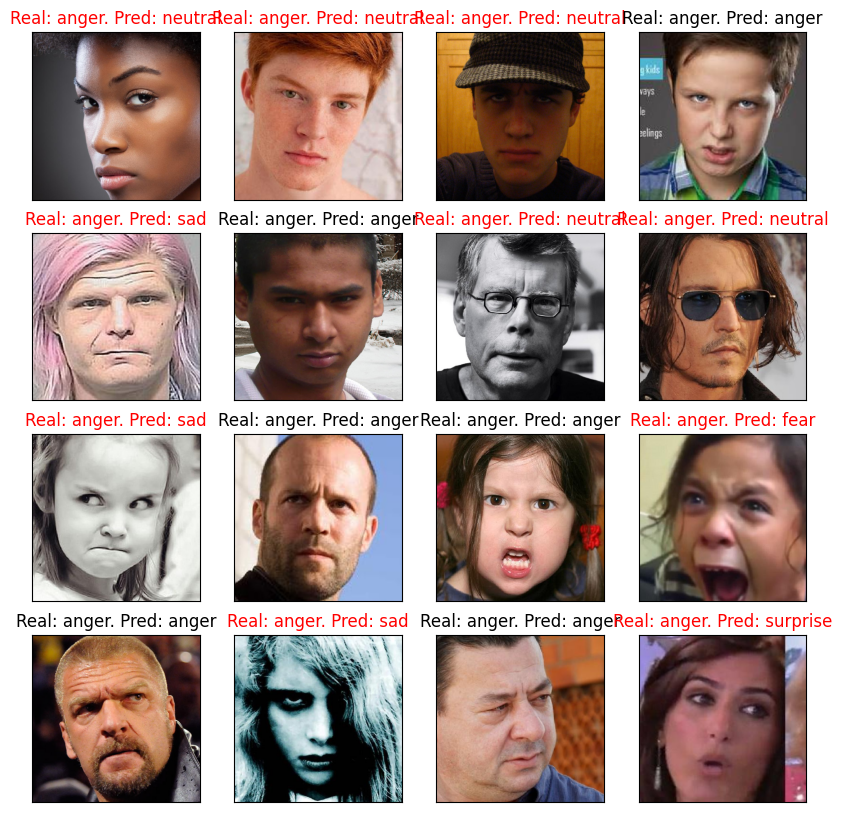

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(fine_tune_model_2.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(fine_tune_model_2, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,neutral
2,2.jpg,sad
3,3.jpg,disgust
4,4.jpg,neutral
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,fear
4997,4997.jpg,neutral
4998,4998.jpg,anger


In [ ]:
answer_df.to_csv('answer5.csv', index = False)

**0.4372 на private kaggle**

# Transfer Learning EfficientNetV2B0

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 224
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_3 = tf.keras.applications.EfficientNetV2B0(
    weights="imagenet",
    include_top=False,
    include_preprocessing=True,
    input_shape = (IMAGE_SIZE, IMAGE_SIZE, 3),
    classifier_activation=None
)
base_model_3.trainable = False

2023-03-26 21:34:29.525379: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-26 21:34:30.062741: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5693 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


In [ ]:
base_model_3.summary()

Model: "efficientnetv2-b0"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_2 (Rescaling)        (None, 224, 224, 3)  0           ['input_3[0][0]']                
                                                                                                  
 normalization_1 (Normalization  (None, 224, 224, 3)  0          ['rescaling_2[0][0]']            
 )                                                                                                
                                                                                  

 ivation)                                                                                         
                                                                                                  
 block3b_project_conv (Conv2D)  (None, 28, 28, 48)   9216        ['block3b_expand_activation[0][0]
                                                                 ']                               
                                                                                                  
 block3b_project_bn (BatchNorma  (None, 28, 28, 48)  192         ['block3b_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block3b_drop (Dropout)         (None, 28, 28, 48)   0           ['block3b_project_bn[0][0]']     
                                                                                                  
 block3b_a

 block4b_add (Add)              (None, 14, 14, 96)   0           ['block4b_drop[0][0]',           
                                                                  'block4a_project_bn[0][0]']     
                                                                                                  
 block4c_expand_conv (Conv2D)   (None, 14, 14, 384)  36864       ['block4b_add[0][0]']            
                                                                                                  
 block4c_expand_bn (BatchNormal  (None, 14, 14, 384)  1536       ['block4c_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block4c_expand_activation (Act  (None, 14, 14, 384)  0          ['block4c_expand_bn[0][0]']      
 ivation)                                                                                         
          

                                                                                                  
 block5b_dwconv2 (DepthwiseConv  (None, 14, 14, 672)  6048       ['block5b_expand_activation[0][0]
 2D)                                                             ']                               
                                                                                                  
 block5b_bn (BatchNormalization  (None, 14, 14, 672)  2688       ['block5b_dwconv2[0][0]']        
 )                                                                                                
                                                                                                  
 block5b_activation (Activation  (None, 14, 14, 672)  0          ['block5b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block5b_s

 )                                                                                                
                                                                                                  
 block5d_activation (Activation  (None, 14, 14, 672)  0          ['block5d_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block5d_se_squeeze (GlobalAver  (None, 672)         0           ['block5d_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block5d_se_reshape (Reshape)   (None, 1, 1, 672)    0           ['block5d_se_squeeze[0][0]']     
                                                                                                  
 block5d_s

 block6a_se_squeeze (GlobalAver  (None, 672)         0           ['block6a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block6a_se_reshape (Reshape)   (None, 1, 1, 672)    0           ['block6a_se_squeeze[0][0]']     
                                                                                                  
 block6a_se_reduce (Conv2D)     (None, 1, 1, 28)     18844       ['block6a_se_reshape[0][0]']     
                                                                                                  
 block6a_se_expand (Conv2D)     (None, 1, 1, 672)    19488       ['block6a_se_reduce[0][0]']      
                                                                                                  
 block6a_se_excite (Multiply)   (None, 7, 7, 672)    0           ['block6a_activation[0][0]',     
          

                                                                  'block6c_se_expand[0][0]']      
                                                                                                  
 block6c_project_conv (Conv2D)  (None, 7, 7, 192)    221184      ['block6c_se_excite[0][0]']      
                                                                                                  
 block6c_project_bn (BatchNorma  (None, 7, 7, 192)   768         ['block6c_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block6c_drop (Dropout)         (None, 7, 7, 192)    0           ['block6c_project_bn[0][0]']     
                                                                                                  
 block6c_add (Add)              (None, 7, 7, 192)    0           ['block6c_drop[0][0]',           
          

 lization)                                                                                        
                                                                                                  
 block6e_drop (Dropout)         (None, 7, 7, 192)    0           ['block6e_project_bn[0][0]']     
                                                                                                  
 block6e_add (Add)              (None, 7, 7, 192)    0           ['block6e_drop[0][0]',           
                                                                  'block6d_add[0][0]']            
                                                                                                  
 block6f_expand_conv (Conv2D)   (None, 7, 7, 1152)   221184      ['block6e_add[0][0]']            
                                                                                                  
 block6f_expand_bn (BatchNormal  (None, 7, 7, 1152)  4608        ['block6f_expand_conv[0][0]']    
 ization) 

                                                                  'block6f_add[0][0]']            
                                                                                                  
 block6h_expand_conv (Conv2D)   (None, 7, 7, 1152)   221184      ['block6g_add[0][0]']            
                                                                                                  
 block6h_expand_bn (BatchNormal  (None, 7, 7, 1152)  4608        ['block6h_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block6h_expand_activation (Act  (None, 7, 7, 1152)  0           ['block6h_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block6h_d

In [ ]:
transf_learn_model_3 = tf.keras.Sequential([
  base_model_3,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=100,
    decay_rate=0.9)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model_3', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
transf_learn_model_3.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

In [ ]:
transf_learn_model_3.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-b0 (Function  (None, 7, 7, 1280)       5919312   
 al)                                                             
                                                                 
 global_average_pooling2d_1   (None, 1280)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_2 (Dense)             (None, 512)               655872    
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_3 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 6,579,801
Trainable params: 660,489
Non-

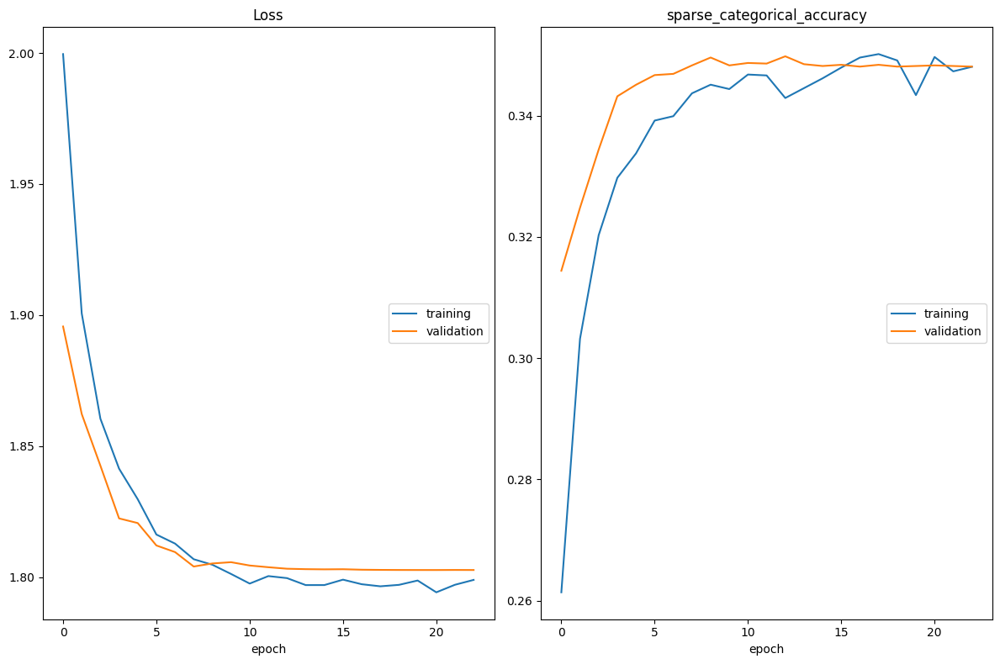

Loss
	training         	 (min:    1.794, max:    2.000, cur:    1.799)
	validation       	 (min:    1.803, max:    1.896, cur:    1.803)
sparse_categorical_accuracy
	training         	 (min:    0.261, max:    0.350, cur:    0.348)
	validation       	 (min:    0.314, max:    0.350, cur:    0.348)
385/385 [==============================] - 362s 941ms/step - loss: 1.7990 - sparse_categorical_accuracy: 0.3481 - val_loss: 1.8028 - val_sparse_categorical_accuracy: 0.3481
Epoch 23: early stopping


In [ ]:
EPOCHS = 50
history = transf_learn_model_3.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
transf_learn_model_3 = load_model(os.path.join(os.getcwd(),'CPT', 'transf_learn_model_3', '13_checkpoint_0.350'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(transf_learn_model_3, ITER, test_df, IMAGE_SIZE)

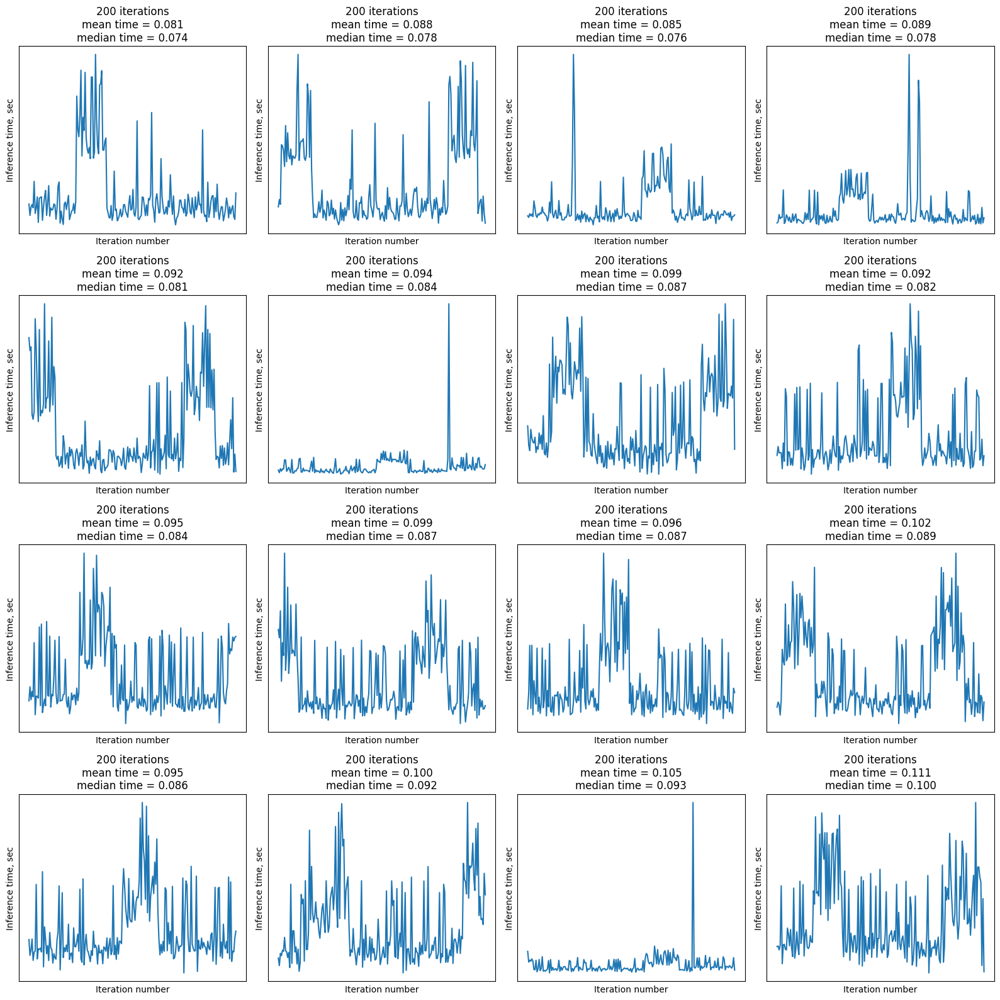

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.0951920124143362 0.08487550169229507


In [ ]:
loss, acc = transf_learn_model_3.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 2540s - loss: 1.8035 - sparse_categorical_accuracy: 0.3494 - 2540s/epoch - 26s/step
Restored model, accuracy: 34.94%


4/4 [==============================] - 4s 219ms/step


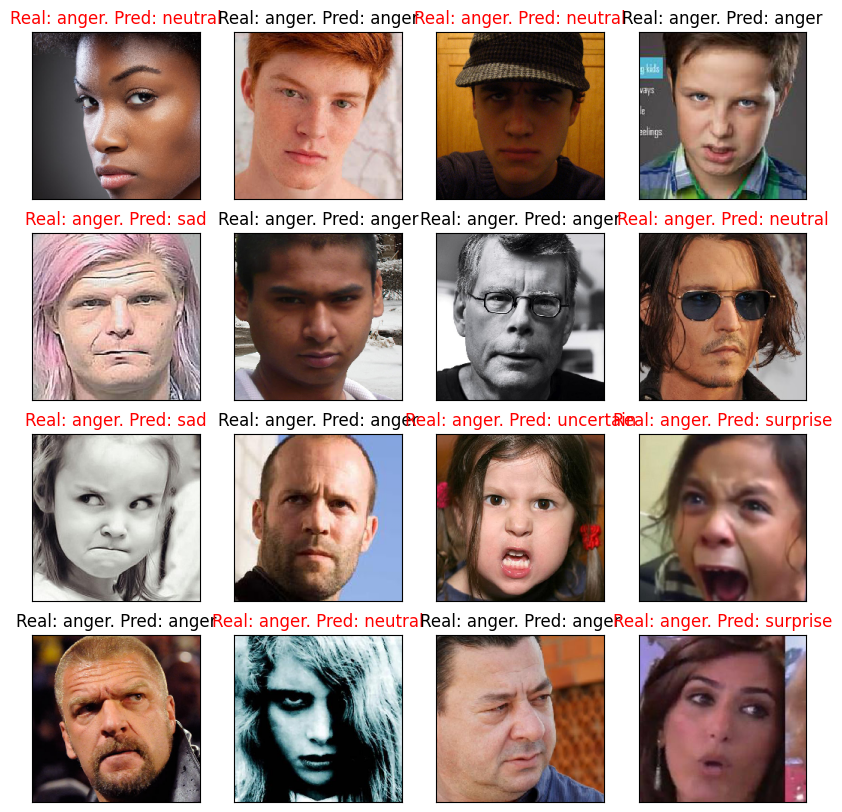

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(transf_learn_model_3.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model_3, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,neutral
2,2.jpg,anger
3,3.jpg,disgust
4,4.jpg,neutral
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,neutral
4998,4998.jpg,sad


In [ ]:
answer_df.to_csv('answer6.csv', index = False)

**0.3408 на private kaggle**

# Fine Tuning EfficientNetV2B0

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 224
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_3.trainable = True
print("Количество слоев в базовой модели: ", len(base_model_3.layers))

Количество слоев в базовой модели:  270


In [ ]:
fine_tune_at = 240
for layer in base_model_3.layers[:fine_tune_at]:
    layer.trainable =  False

In [ ]:
for i in range(fine_tune_at - 4, len(base_model_3.layers)):
    print(f'Слой {base_model_3.layers[i].name}, trainable = {base_model_3.layers[i].trainable}')

Слой block6f_add, trainable = False
Слой block6g_expand_conv, trainable = False
Слой block6g_expand_bn, trainable = False
Слой block6g_expand_activation, trainable = False
Слой block6g_dwconv2, trainable = True
Слой block6g_bn, trainable = True
Слой block6g_activation, trainable = True
Слой block6g_se_squeeze, trainable = True
Слой block6g_se_reshape, trainable = True
Слой block6g_se_reduce, trainable = True
Слой block6g_se_expand, trainable = True
Слой block6g_se_excite, trainable = True
Слой block6g_project_conv, trainable = True
Слой block6g_project_bn, trainable = True
Слой block6g_drop, trainable = True
Слой block6g_add, trainable = True
Слой block6h_expand_conv, trainable = True
Слой block6h_expand_bn, trainable = True
Слой block6h_expand_activation, trainable = True
Слой block6h_dwconv2, trainable = True
Слой block6h_bn, trainable = True
Слой block6h_activation, trainable = True
Слой block6h_se_squeeze, trainable = True
Слой block6h_se_reshape, trainable = True
Слой block6h_se_r

In [ ]:
fine_tune_model_3 = tf.keras.Sequential([
  base_model_3,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

In [ ]:
fine_tune_model_3.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 efficientnetv2-b0 (Function  (None, 7, 7, 1280)       5919312   
 al)                                                             
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               655872    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 6,579,801
Trainable params: 1,824,361
Non-

In [ ]:
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-5,
    decay_steps=100,
    decay_rate=0.98)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'fine_tune_model_3', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
fine_tune_model_3.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

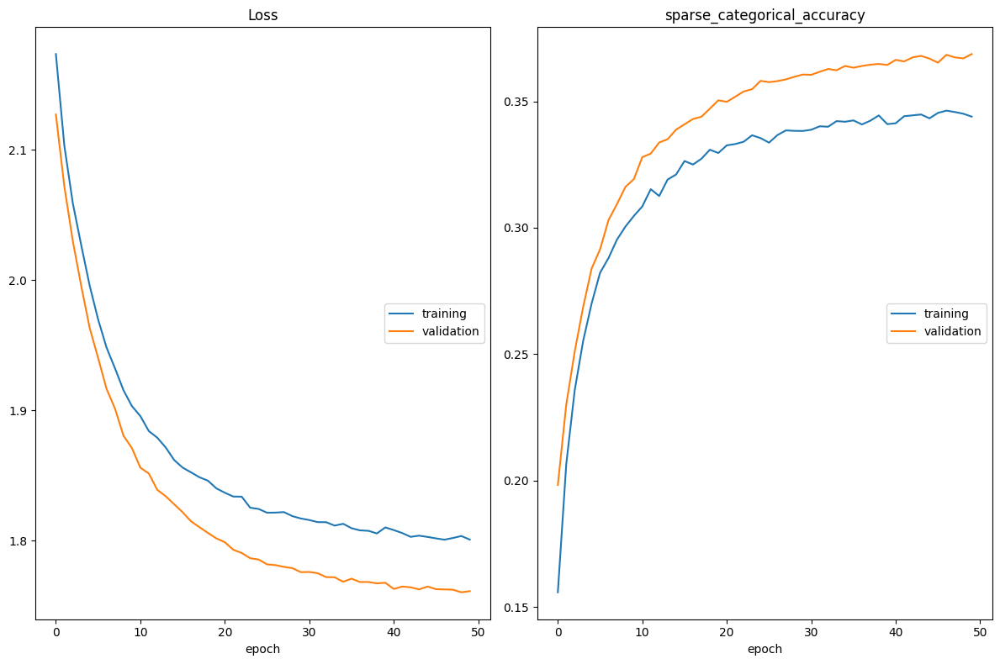

Loss
	training         	 (min:    1.801, max:    2.173, cur:    1.801)
	validation       	 (min:    1.760, max:    2.127, cur:    1.761)
sparse_categorical_accuracy
	training         	 (min:    0.156, max:    0.346, cur:    0.344)
	validation       	 (min:    0.198, max:    0.369, cur:    0.369)
385/385 [==============================] - 391s 1s/step - loss: 1.8008 - sparse_categorical_accuracy: 0.3439 - val_loss: 1.7613 - val_sparse_categorical_accuracy: 0.3687


In [ ]:
EPOCHS = 50
history = fine_tune_model_3.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
fine_tune_model_3 = load_model(os.path.join(os.getcwd(),'CPT', 'fine_tune_model_3', '50_checkpoint_0.369'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(fine_tune_model_3, ITER, test_df, IMAGE_SIZE)

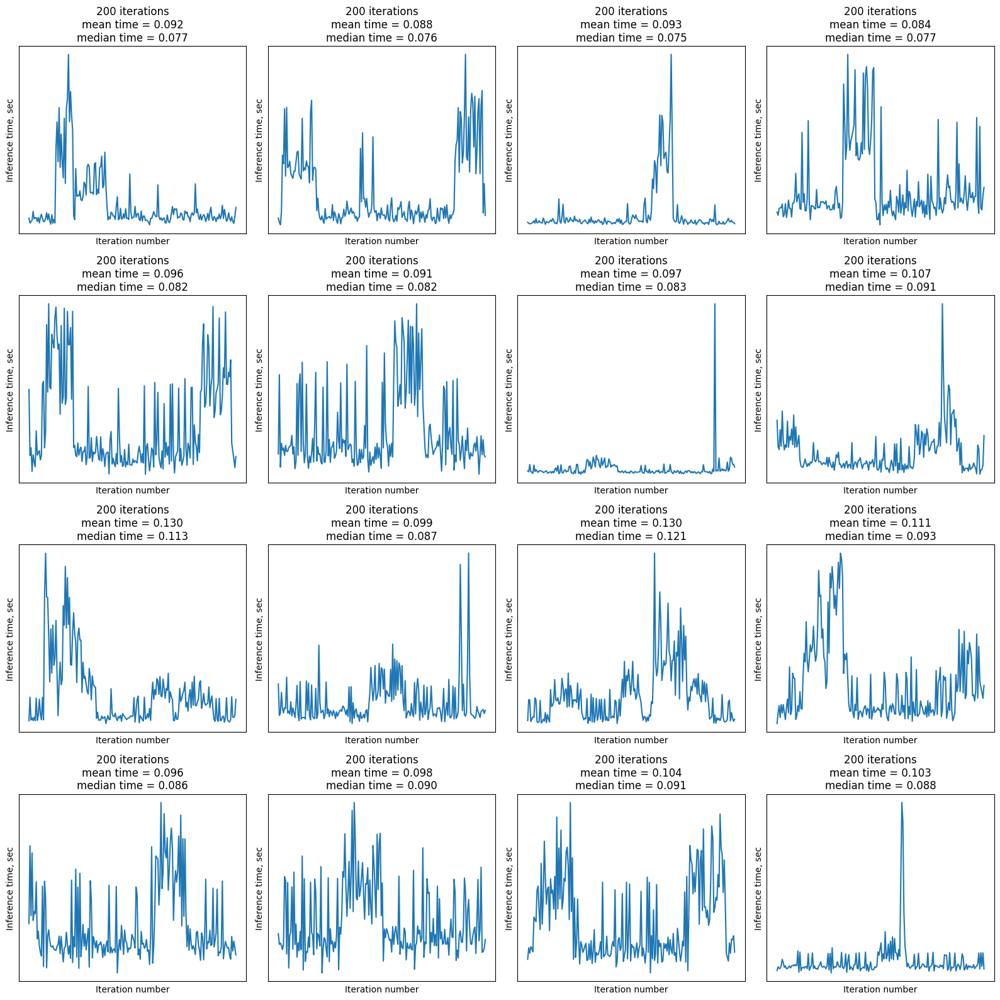

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.10116748459637165 0.08830874413251877


In [ ]:
loss, acc = fine_tune_model_3.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 107s - loss: 1.7613 - sparse_categorical_accuracy: 0.3680 - 107s/epoch - 1s/step
Restored model, accuracy: 36.80%


4/4 [==============================] - 2s 61ms/step


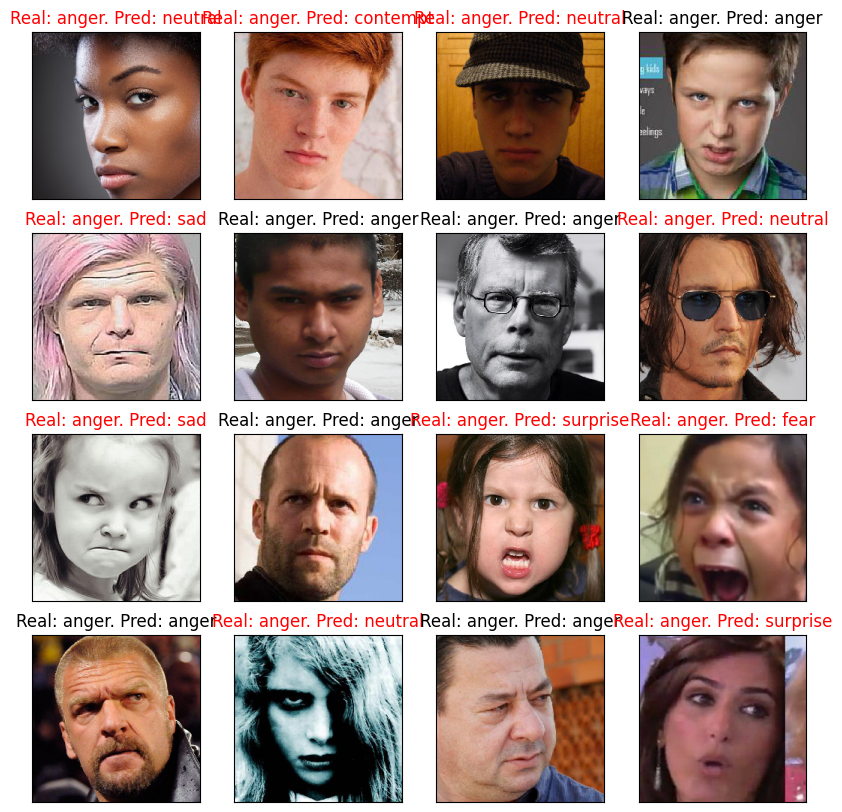

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(sample_val_images, sample_val_labels, np.argmax(fine_tune_model_3.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(fine_tune_model_3, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,neutral
2,2.jpg,anger
3,3.jpg,happy
4,4.jpg,contempt
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,neutral
4998,4998.jpg,surprise


In [ ]:
answer_df.to_csv('answer7.csv', index = False)

**0.3576 на private kaggle**

# Transfer Learning Xception

In [ ]:
from keras.applications.xception import preprocess_input

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 299
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE, prep = preprocess_input)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE, prep = preprocess_input)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_4 = tf.keras.applications.Xception(
    weights="imagenet",
    include_top=False,
    input_shape = (IMAGE_SIZE, IMAGE_SIZE, 3),
    classifier_activation=None
)
base_model_4.trainable = False

2023-03-29 21:36:07.915123: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-29 21:36:08.475937: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5758 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


In [ ]:
base_model_4.summary()

Model: "xception"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 149, 149, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 149, 149, 32  128        ['block1_conv1[0][0]']           
 ation)                         )                                                          

 block4_sepconv1_bn (BatchNorma  (None, 37, 37, 728)  2912       ['block4_sepconv1[0][0]']        
 lization)                                                                                        
                                                                                                  
 block4_sepconv2_act (Activatio  (None, 37, 37, 728)  0          ['block4_sepconv1_bn[0][0]']     
 n)                                                                                               
                                                                                                  
 block4_sepconv2 (SeparableConv  (None, 37, 37, 728)  536536     ['block4_sepconv2_act[0][0]']    
 2D)                                                                                              
                                                                                                  
 block4_sepconv2_bn (BatchNorma  (None, 37, 37, 728)  2912       ['block4_sepconv2[0][0]']        
 lization)

 n)                                                                                               
                                                                                                  
 block7_sepconv1 (SeparableConv  (None, 19, 19, 728)  536536     ['block7_sepconv1_act[0][0]']    
 2D)                                                                                              
                                                                                                  
 block7_sepconv1_bn (BatchNorma  (None, 19, 19, 728)  2912       ['block7_sepconv1[0][0]']        
 lization)                                                                                        
                                                                                                  
 block7_sepconv2_act (Activatio  (None, 19, 19, 728)  0          ['block7_sepconv1_bn[0][0]']     
 n)                                                                                               
          

 block9_sepconv3_bn (BatchNorma  (None, 19, 19, 728)  2912       ['block9_sepconv3[0][0]']        
 lization)                                                                                        
                                                                                                  
 add_7 (Add)                    (None, 19, 19, 728)  0           ['block9_sepconv3_bn[0][0]',     
                                                                  'add_6[0][0]']                  
                                                                                                  
 block10_sepconv1_act (Activati  (None, 19, 19, 728)  0          ['add_7[0][0]']                  
 on)                                                                                              
                                                                                                  
 block10_sepconv1 (SeparableCon  (None, 19, 19, 728)  536536     ['block10_sepconv1_act[0][0]']   
 v2D)     

                                                                                                  
 block12_sepconv3_act (Activati  (None, 19, 19, 728)  0          ['block12_sepconv2_bn[0][0]']    
 on)                                                                                              
                                                                                                  
 block12_sepconv3 (SeparableCon  (None, 19, 19, 728)  536536     ['block12_sepconv3_act[0][0]']   
 v2D)                                                                                             
                                                                                                  
 block12_sepconv3_bn (BatchNorm  (None, 19, 19, 728)  2912       ['block12_sepconv3[0][0]']       
 alization)                                                                                       
                                                                                                  
 add_10 (A

In [ ]:
transf_learn_model_4 = tf.keras.Sequential([
  base_model_4,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=100,
    decay_rate=0.9)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model_4', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
transf_learn_model_4.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

In [ ]:
transf_learn_model_4.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 xception (Functional)       (None, 10, 10, 2048)      20861480  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               1049088   
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 21,915,185
Trainable params: 1,053,705
Non-trainable params: 20,861,480
____________________________________

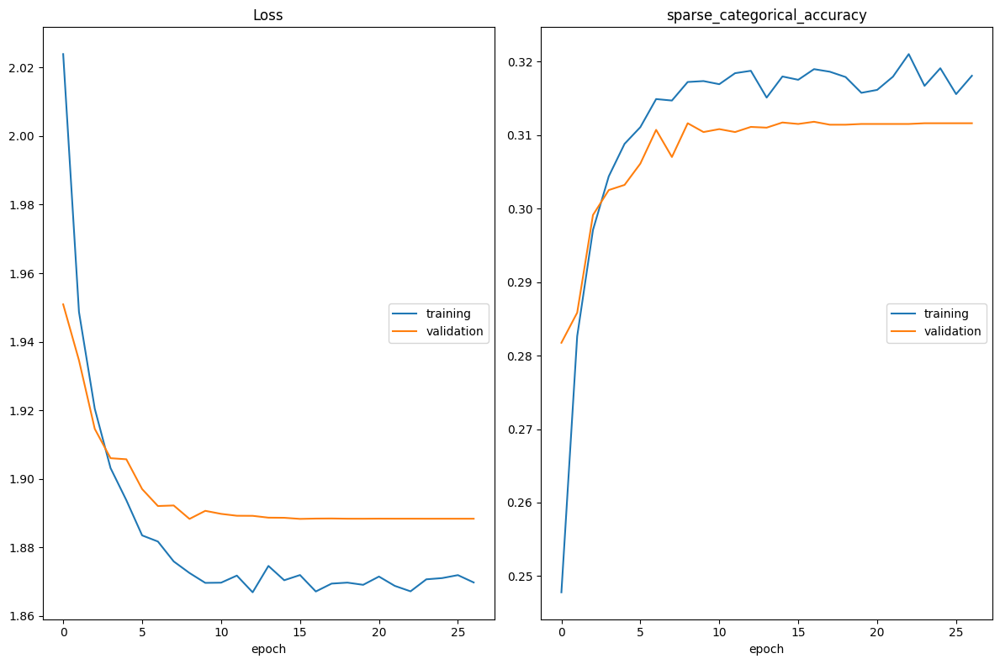

Loss
	training         	 (min:    1.867, max:    2.024, cur:    1.870)
	validation       	 (min:    1.888, max:    1.951, cur:    1.888)
sparse_categorical_accuracy
	training         	 (min:    0.248, max:    0.321, cur:    0.318)
	validation       	 (min:    0.282, max:    0.312, cur:    0.312)
385/385 [==============================] - 586s 2s/step - loss: 1.8698 - sparse_categorical_accuracy: 0.3181 - val_loss: 1.8884 - val_sparse_categorical_accuracy: 0.3116
Epoch 27: early stopping


In [ ]:
EPOCHS = 50
history = transf_learn_model_4.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
transf_learn_model_4 = load_model(os.path.join(os.getcwd(),'CPT', 'transf_learn_model_4', '17_checkpoint_0.312'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(transf_learn_model_4, ITER, test_df, IMAGE_SIZE)

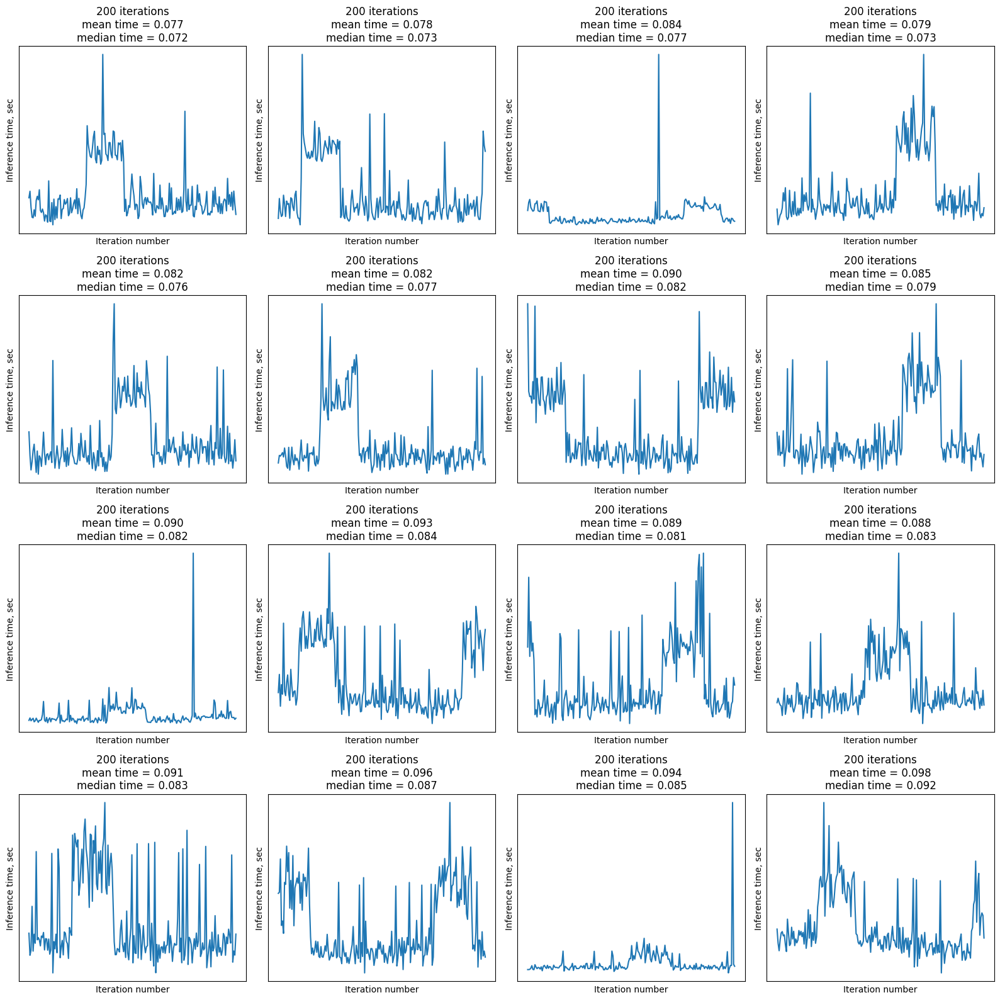

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.08724049903452397 0.08035839349031448


In [ ]:
loss, acc = transf_learn_model_4.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 3379s - loss: 1.8886 - sparse_categorical_accuracy: 0.3113 - 3379s/epoch - 35s/step
Restored model, accuracy: 31.13%


4/4 [==============================] - 1s 251ms/step


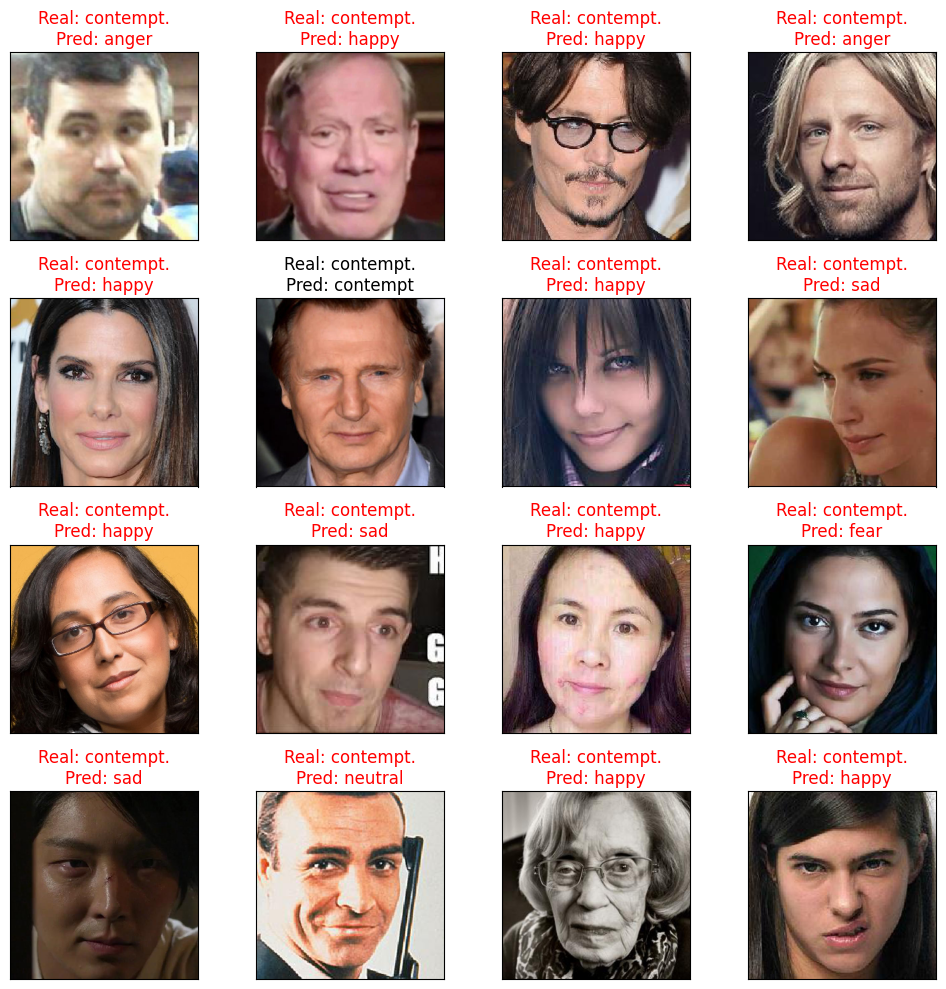

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(normalize_0_1(sample_val_images), sample_val_labels, np.argmax(transf_learn_model_4.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model_4, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,surprise
1,1.jpg,surprise
2,2.jpg,surprise
3,3.jpg,surprise
4,4.jpg,surprise
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,surprise
4997,4997.jpg,surprise
4998,4998.jpg,surprise


In [ ]:
answer_df.to_csv('answer8.csv', index = False)

**0.1312 на private kaggle**

# Fine Tuning Xception

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 224
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE)

In [ ]:
base_model_4.trainable = True
print("Количество слоев в базовой модели: ", len(base_model_4.layers))

Количество слоев в базовой модели:  132


In [ ]:
fine_tune_at = 122
for layer in base_model_4.layers[:fine_tune_at]:
    layer.trainable =  False

In [ ]:
for i in range(fine_tune_at - 4, len(base_model_4.layers)):
    print(f'Слой {base_model_4.layers[i].name}, trainable = {base_model_4.layers[i].trainable}')

Слой block13_sepconv1_bn, trainable = False
Слой block13_sepconv2_act, trainable = False
Слой block13_sepconv2, trainable = False
Слой block13_sepconv2_bn, trainable = False
Слой conv2d_3, trainable = True
Слой block13_pool, trainable = True
Слой batch_normalization_3, trainable = True
Слой add_11, trainable = True
Слой block14_sepconv1, trainable = True
Слой block14_sepconv1_bn, trainable = True
Слой block14_sepconv1_act, trainable = True
Слой block14_sepconv2, trainable = True
Слой block14_sepconv2_bn, trainable = True
Слой block14_sepconv2_act, trainable = True


In [ ]:
fine_tune_model_4 = tf.keras.Sequential([
  base_model_4,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

In [ ]:
fine_tune_model_4.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 xception (Functional)       (None, 7, 7, 2048)        20861480  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               1049088   
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 21,915,185
Trainable params: 6,550,025
Non-trainable params: 15,365,160
____________________________________

In [ ]:
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-5,
    decay_steps=100,
    decay_rate=0.98)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'fine_tune_model_4', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
fine_tune_model_4.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

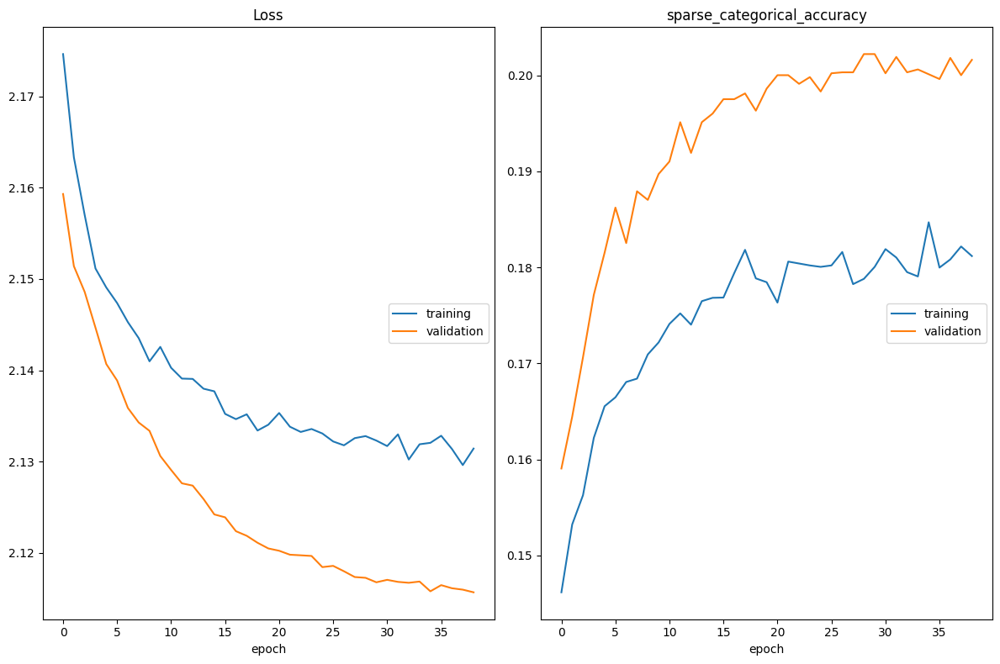

Loss
	training         	 (min:    2.130, max:    2.175, cur:    2.131)
	validation       	 (min:    2.116, max:    2.159, cur:    2.116)
sparse_categorical_accuracy
	training         	 (min:    0.146, max:    0.185, cur:    0.181)
	validation       	 (min:    0.159, max:    0.202, cur:    0.202)
385/385 [==============================] - 364s 945ms/step - loss: 2.1314 - sparse_categorical_accuracy: 0.1812 - val_loss: 2.1157 - val_sparse_categorical_accuracy: 0.2016
Epoch 39: early stopping


In [ ]:
EPOCHS = 50
history = fine_tune_model_4.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
fine_tune_model_4 = load_model(os.path.join(os.getcwd(),'CPT', 'fine_tune_model_4', '29_checkpoint_0.202'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(fine_tune_model_4, ITER, test_df, IMAGE_SIZE)

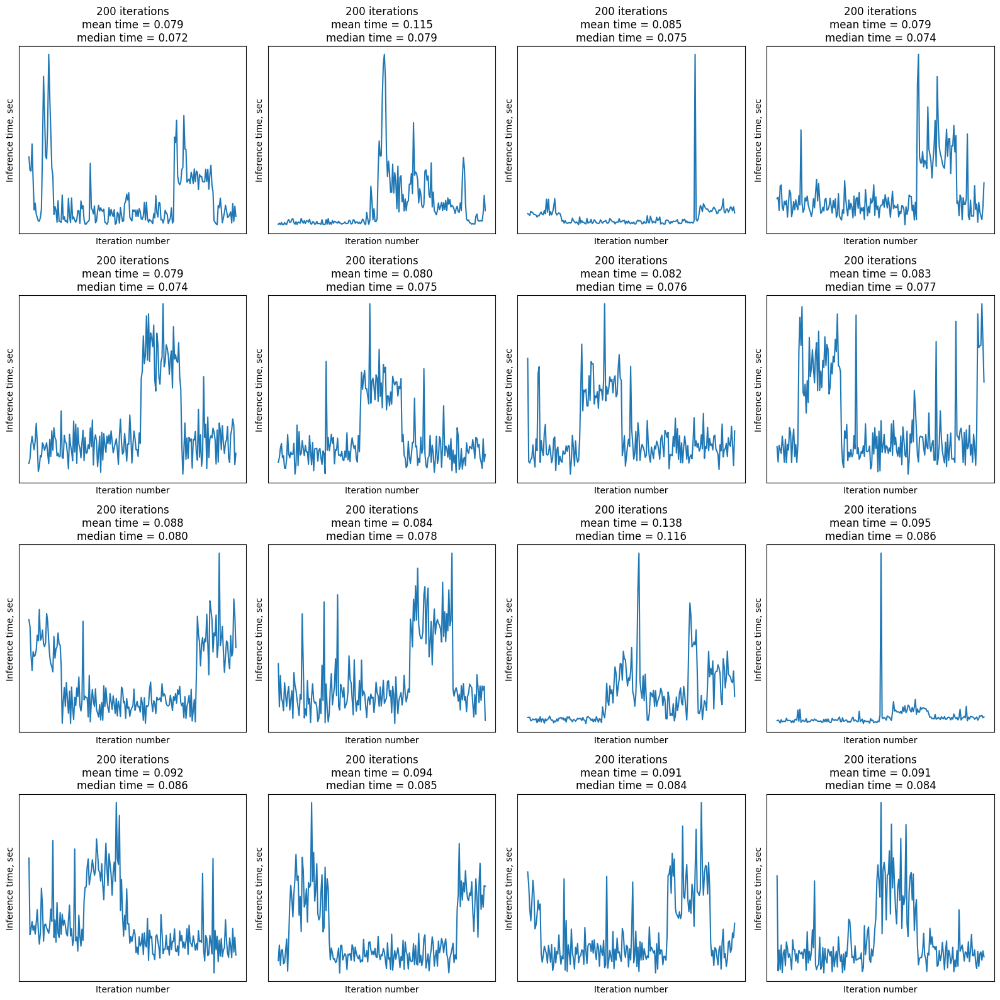

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.09095153257250786 0.08129966259002686


In [ ]:
loss, acc = fine_tune_model_4.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 107s - loss: 2.1173 - sparse_categorical_accuracy: 0.2026 - 107s/epoch - 1s/step
Restored model, accuracy: 20.26%


4/4 [==============================] - 4s 282ms/step


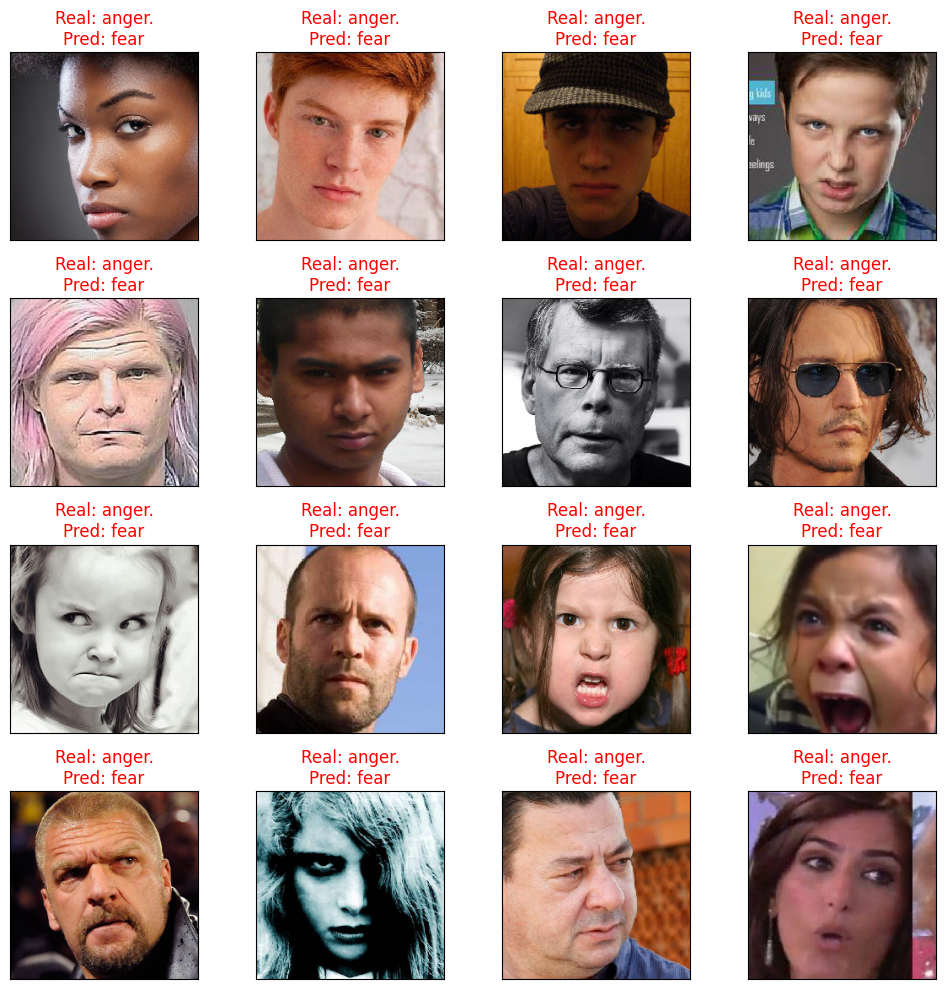

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(normalize_0_1(sample_val_images), sample_val_labels, np.argmax(fine_tune_model_4.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(fine_tune_model_4, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,sad
1,1.jpg,happy
2,2.jpg,surprise
3,3.jpg,anger
4,4.jpg,neutral
...,...,...
4995,4995.jpg,happy
4996,4996.jpg,anger
4997,4997.jpg,surprise
4998,4998.jpg,sad


In [ ]:
answer_df.to_csv('answer9.csv', index = False)

**0.194 на private kaggle**

# Transfer Learning VGG19

In [ ]:
from keras.applications.vgg19 import preprocess_input

In [ ]:
BATCH_SIZE = 104
IMAGE_SIZE = 224
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE, BATCH_SIZE,resc = 1./255, prep = preprocess_input)
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE, BATCH_SIZE, resc = 1./255, prep = preprocess_input)

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_5 = tf.keras.applications.VGG19(
    weights="imagenet",
    include_top=False,
    input_shape = (IMAGE_SIZE, IMAGE_SIZE, 3),
    classifier_activation=None
)
base_model_5.trainable = False

2023-03-28 22:22:15.724361: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-03-28 22:22:16.299492: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1613] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 5669 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 3070, pci bus id: 0000:05:00.0, compute capability: 8.6


80134624/80134624 [==============================] - 9s 0us/step


In [ ]:
base_model_5.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

In [ ]:
transf_learn_model_5 = tf.keras.Sequential([
  base_model_5,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=100,
    decay_rate=0.9)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model_5', '{epoch:02d}_checkpoint_{val_sparse_categorical_accuracy:.3f}'),
                             monitor = 'val_sparse_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_sparse_categorical_accuracy', mode='max', verbose=1, patience=10)
transf_learn_model_5.compile(loss=tf.keras.losses.SparseCategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.SparseCategoricalAccuracy()])

In [ ]:
transf_learn_model_5.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 7, 7, 512)         20024384  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 512)               262656    
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense_1 (Dense)             (None, 9)                 4617      
                                                                 
Total params: 20,291,657
Trainable params: 267,273
Non-trainable params: 20,024,384
______________________________________

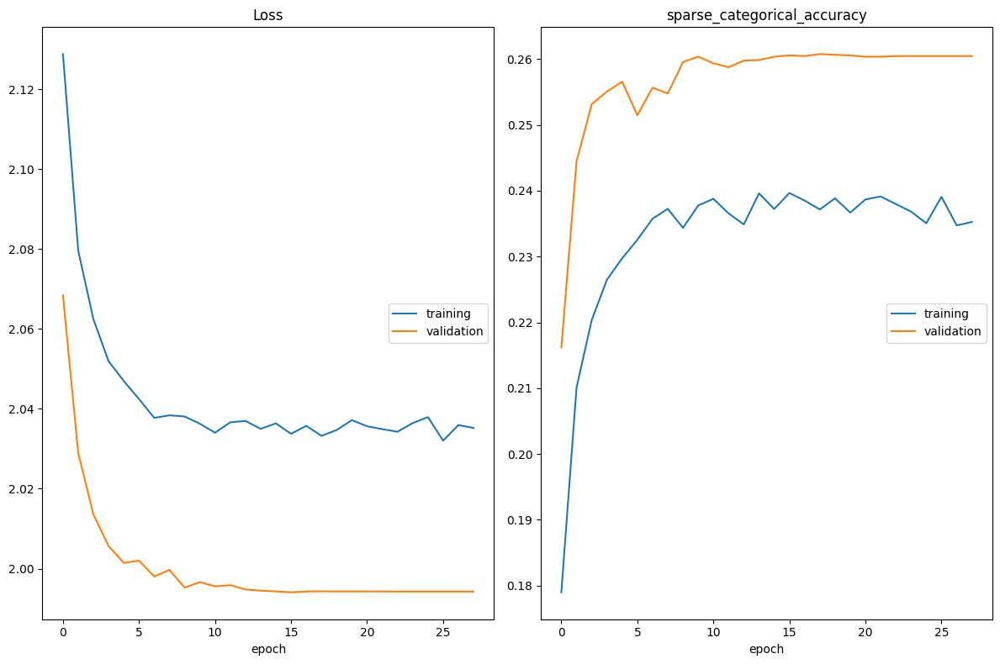

Loss
	training         	 (min:    2.032, max:    2.129, cur:    2.035)
	validation       	 (min:    1.994, max:    2.068, cur:    1.994)
sparse_categorical_accuracy
	training         	 (min:    0.179, max:    0.240, cur:    0.235)
	validation       	 (min:    0.216, max:    0.261, cur:    0.260)
385/385 [==============================] - 380s 986ms/step - loss: 2.0352 - sparse_categorical_accuracy: 0.2353 - val_loss: 1.9943 - val_sparse_categorical_accuracy: 0.2605
Epoch 28: early stopping


In [ ]:
EPOCHS = 50
history = transf_learn_model_5.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
transf_learn_model_5 = load_model(os.path.join(os.getcwd(),'CPT', 'transf_learn_model_5', '18_checkpoint_0.261'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(transf_learn_model_5, ITER, test_df, IMAGE_SIZE)

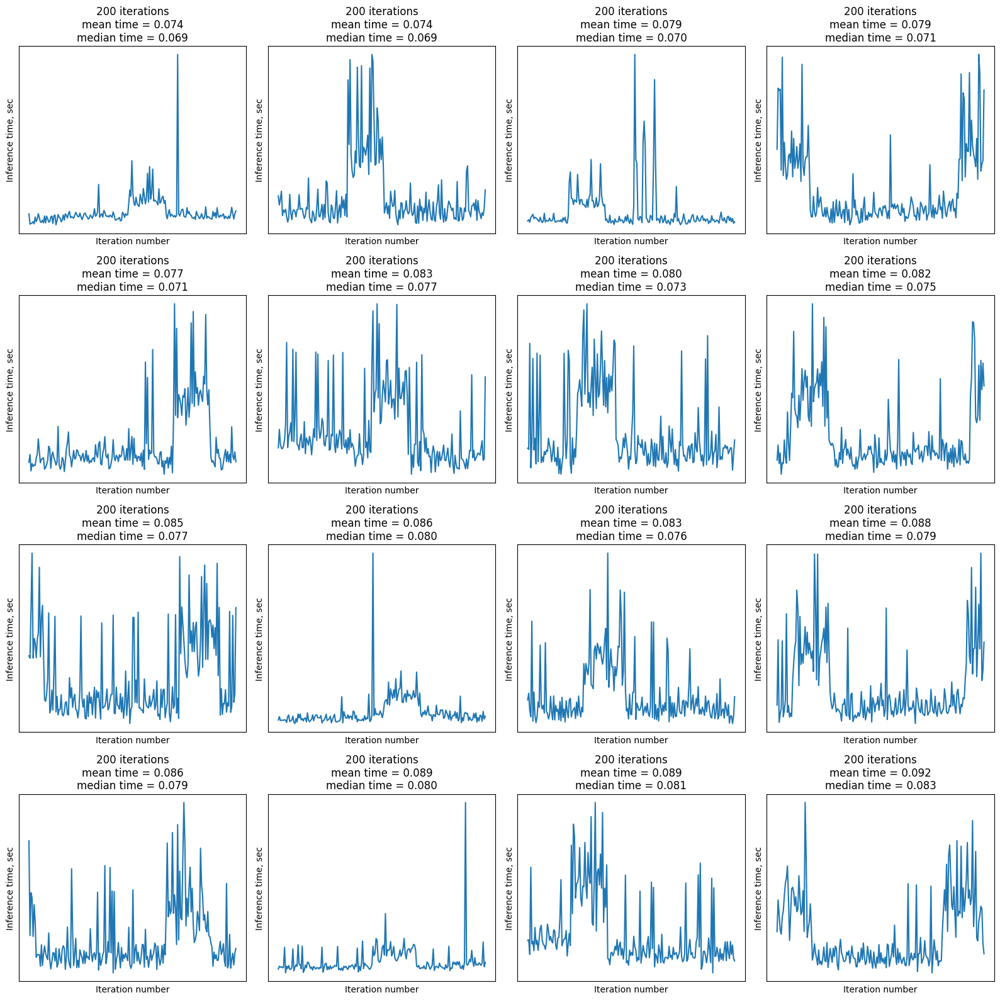

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.08282824322581292 0.07560756057500839


In [ ]:
loss, acc = transf_learn_model_5.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

97/97 - 2347s - loss: 1.9943 - sparse_categorical_accuracy: 0.2613 - 2347s/epoch - 24s/step
Restored model, accuracy: 26.13%


4/4 [==============================] - 1s 169ms/step


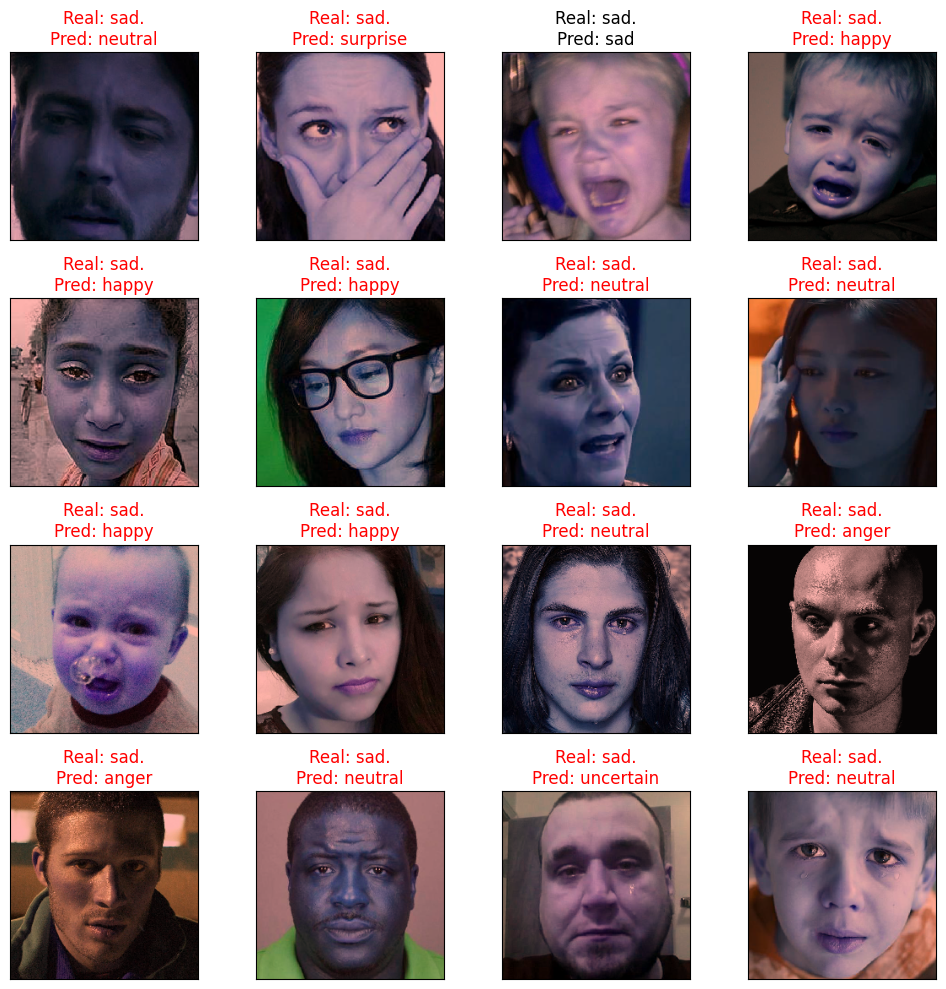

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(normalize_0_1(sample_val_images), sample_val_labels, np.argmax(transf_learn_model_5.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model_5, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,anger
1,1.jpg,neutral
2,2.jpg,fear
3,3.jpg,surprise
4,4.jpg,anger
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,anger
4997,4997.jpg,neutral
4998,4998.jpg,surprise


In [ ]:
answer_df.to_csv('answer10.csv', index = False)

**0.2172 на private kaggle**

# Transfer Learning VGGFace

**Попробуем еще одну спецефическую сеть, заточенную на распознавание лиц - VGGFace. Честно признаюсь - интересно было, как другие выполняли дипломную работу. В интернете нашел вариант, где кто-то использовал данную сеть и по его данным получил на ней больше 0.5 на kaggle. Давайте это проверим. Для начала произведем transfer learning.**

In [ ]:
# !pip install keras_vggface
# !pip install keras_applications

In [ ]:
from keras_vggface.vggface import VGGFace
from keras_vggface.utils import preprocess_input

In [ ]:
def preprocess_input_facenet(image_):
    preprocessed = preprocess_input(image_, version=2)
    return preprocessed

In [ ]:
BATCH_SIZE = 40
IMAGE_SIZE = 224
N_CLASSES = 9

In [ ]:
train_data_gen = make_data_generator('train', train_df, IMAGE_SIZE,
                                     BATCH_SIZE,resc = 1./255, prep = preprocess_input_facenet,
                                    mode = 'categorical')
val_data_gen = make_data_generator('val', val_df, IMAGE_SIZE,
                                   BATCH_SIZE, resc = 1./255, prep = preprocess_input_facenet,
                                  mode = 'categorical')

Found 40037 validated image filenames belonging to 9 classes.
Found 10009 validated image filenames belonging to 9 classes.


In [ ]:
base_model_6 = VGGFace(
    model='resnet50',
    include_top=False,
    input_shape = (IMAGE_SIZE, IMAGE_SIZE, 3)
    )
base_model_6.trainable = False

In [ ]:
base_model_6.summary()

Model: "vggface_resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1/7x7_s2 (Conv2D)          (None, 112, 112, 64  9408        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv1/7x7_s2/bn (BatchNormaliz  (None, 112, 112, 64  256        ['conv1/7x7_s2[0][0]']           
 ation)                         )                                                  

                                                                                                  
 conv2_3_1x1_increase (Conv2D)  (None, 55, 55, 256)  16384       ['activation_8[0][0]']           
                                                                                                  
 conv2_3_1x1_increase/bn (Batch  (None, 55, 55, 256)  1024       ['conv2_3_1x1_increase[0][0]']   
 Normalization)                                                                                   
                                                                                                  
 add_2 (Add)                    (None, 55, 55, 256)  0           ['conv2_3_1x1_increase/bn[0][0]',
                                                                  'activation_6[0][0]']           
                                                                                                  
 activation_9 (Activation)      (None, 55, 55, 256)  0           ['add_2[0][0]']                  
          

 add_5 (Add)                    (None, 28, 28, 512)  0           ['conv3_3_1x1_increase/bn[0][0]',
                                                                  'activation_15[0][0]']          
                                                                                                  
 activation_18 (Activation)     (None, 28, 28, 512)  0           ['add_5[0][0]']                  
                                                                                                  
 conv3_4_1x1_reduce (Conv2D)    (None, 28, 28, 128)  65536       ['activation_18[0][0]']          
                                                                                                  
 conv3_4_1x1_reduce/bn (BatchNo  (None, 28, 28, 128)  512        ['conv3_4_1x1_reduce[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 activatio

                                                                                                  
 activation_27 (Activation)     (None, 14, 14, 1024  0           ['add_8[0][0]']                  
                                )                                                                 
                                                                                                  
 conv4_3_1x1_reduce (Conv2D)    (None, 14, 14, 256)  262144      ['activation_27[0][0]']          
                                                                                                  
 conv4_3_1x1_reduce/bn (BatchNo  (None, 14, 14, 256)  1024       ['conv4_3_1x1_reduce[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 activation_28 (Activation)     (None, 14, 14, 256)  0           ['conv4_3_1x1_reduce/bn[0][0]']  
          

                                                                                                  
 conv4_6_1x1_reduce/bn (BatchNo  (None, 14, 14, 256)  1024       ['conv4_6_1x1_reduce[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 activation_37 (Activation)     (None, 14, 14, 256)  0           ['conv4_6_1x1_reduce/bn[0][0]']  
                                                                                                  
 conv4_6_3x3 (Conv2D)           (None, 14, 14, 256)  589824      ['activation_37[0][0]']          
                                                                                                  
 conv4_6_3x3/bn (BatchNormaliza  (None, 14, 14, 256)  1024       ['conv4_6_3x3[0][0]']            
 tion)                                                                                            
          

 activation_46 (Activation)     (None, 7, 7, 512)    0           ['conv5_3_1x1_reduce/bn[0][0]']  
                                                                                                  
 conv5_3_3x3 (Conv2D)           (None, 7, 7, 512)    2359296     ['activation_46[0][0]']          
                                                                                                  
 conv5_3_3x3/bn (BatchNormaliza  (None, 7, 7, 512)   2048        ['conv5_3_3x3[0][0]']            
 tion)                                                                                            
                                                                                                  
 activation_47 (Activation)     (None, 7, 7, 512)    0           ['conv5_3_3x3/bn[0][0]']         
                                                                                                  
 conv5_3_1x1_increase (Conv2D)  (None, 7, 7, 2048)   1048576     ['activation_47[0][0]']          
          

In [ ]:
transf_learn_model_6 = tf.keras.Sequential([
  base_model_6,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=50,
    decay_rate=0.98)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'transf_learn_model_6', '{epoch:02d}_checkpoint_{val_categorical_accuracy:.3f}'),
                             monitor = 'val_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_categorical_accuracy', mode='max', verbose=1, patience=10)
transf_learn_model_6.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.CategoricalAccuracy(),
                      tfa.metrics.F1Score(num_classes = 9, average = 'macro', dtype=tf.float32)])

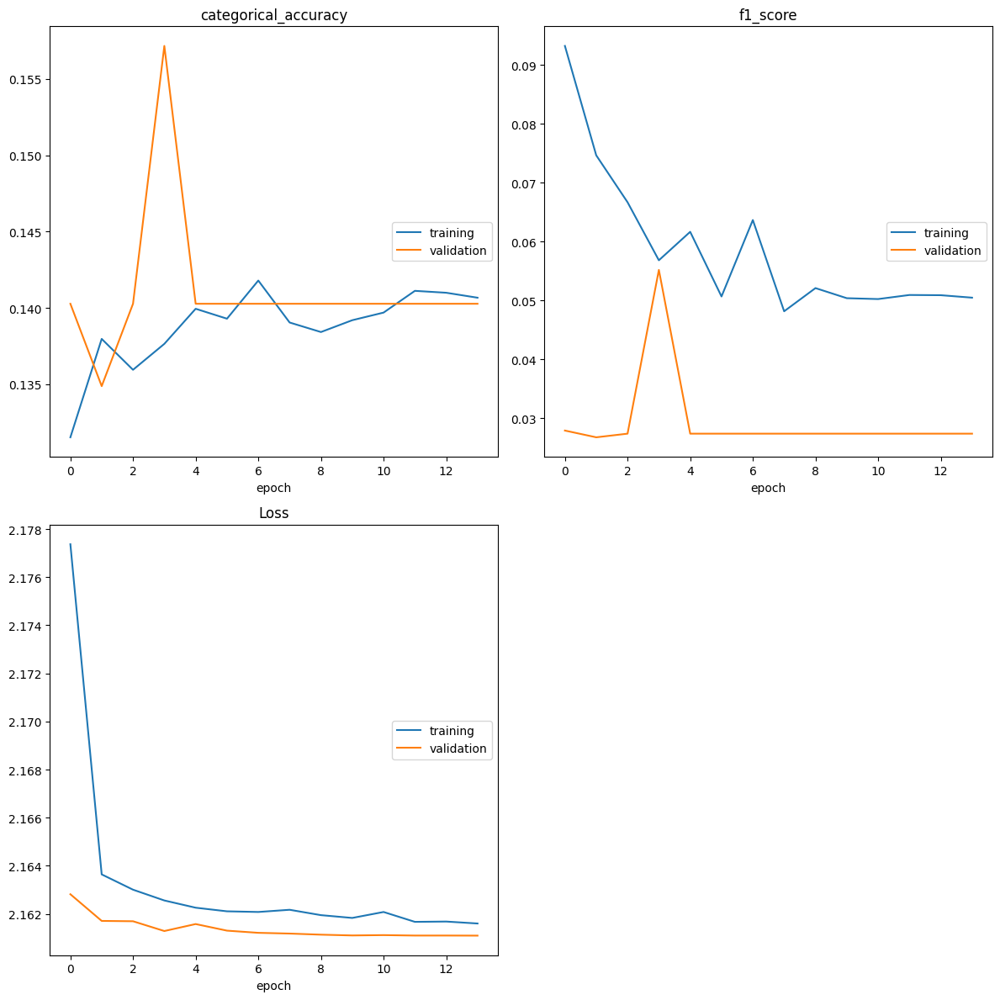

categorical_accuracy
	training         	 (min:    0.132, max:    0.142, cur:    0.141)
	validation       	 (min:    0.135, max:    0.157, cur:    0.140)
f1_score
	training         	 (min:    0.048, max:    0.093, cur:    0.050)
	validation       	 (min:    0.027, max:    0.055, cur:    0.027)
Loss
	training         	 (min:    2.162, max:    2.177, cur:    2.162)
	validation       	 (min:    2.161, max:    2.163, cur:    2.161)
1001/1001 [==============================] - 369s 369ms/step - loss: 2.1616 - categorical_accuracy: 0.1407 - f1_score: 0.0505 - val_loss: 2.1611 - val_categorical_accuracy: 0.1403 - val_f1_score: 0.0273
Epoch 14: early stopping


In [ ]:
EPOCHS = 50
history = transf_learn_model_6.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
transf_learn_model_6 = load_model(os.path.join(os.getcwd(),'CPT', 'transf_learn_model_6', '04_checkpoint_0.157'))

In [ ]:
ITER = 200

absolut_mean_times, absolut_median_times = show_inference_time_plots(transf_learn_model_6, ITER, test_df, IMAGE_SIZE)

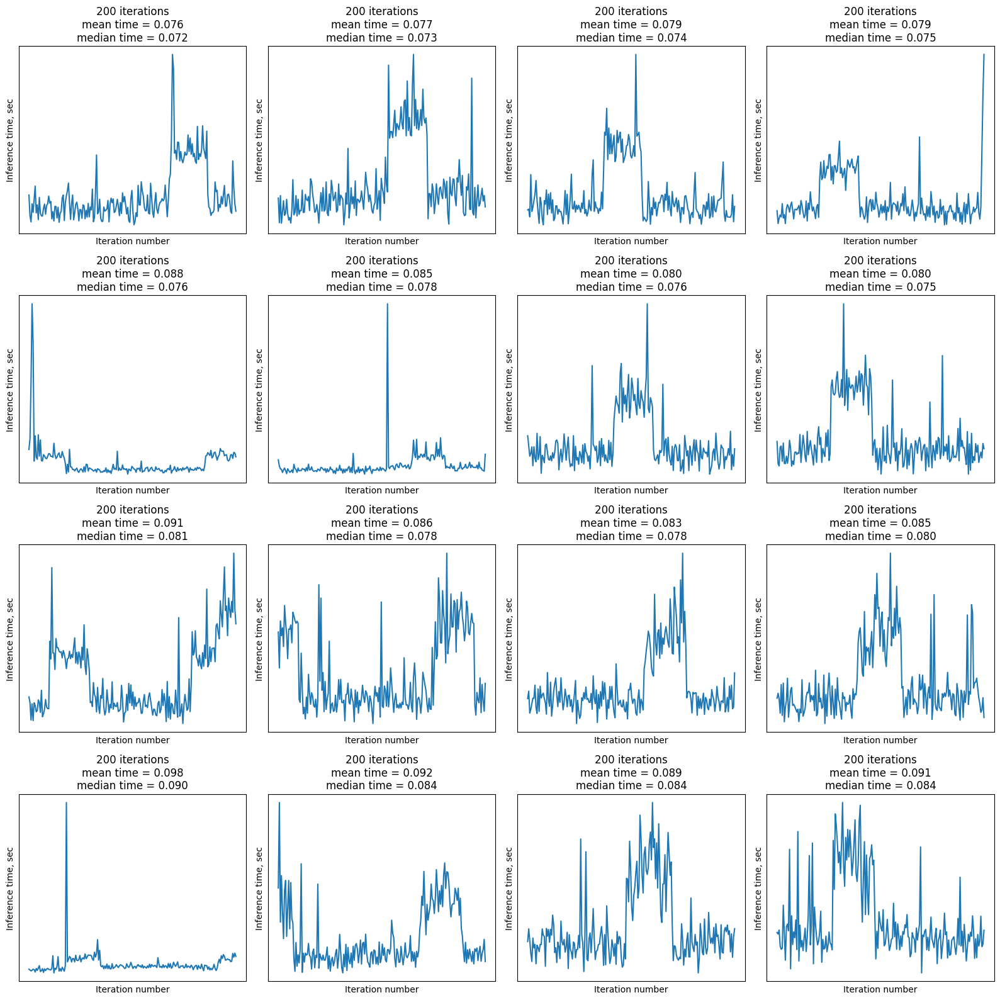

In [ ]:
print(np.mean(absolut_mean_times), np.mean(absolut_median_times))

0.08501955769956113 0.0785435363650322


In [ ]:
loss, acc, _ = transf_learn_model_6.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

251/251 - 22s - loss: 2.1613 - categorical_accuracy: 0.1575 - f1_score: 0.0553 - 22s/epoch - 86ms/step
Restored model, accuracy: 15.75%


2/2 [==============================] - 0s 33ms/step


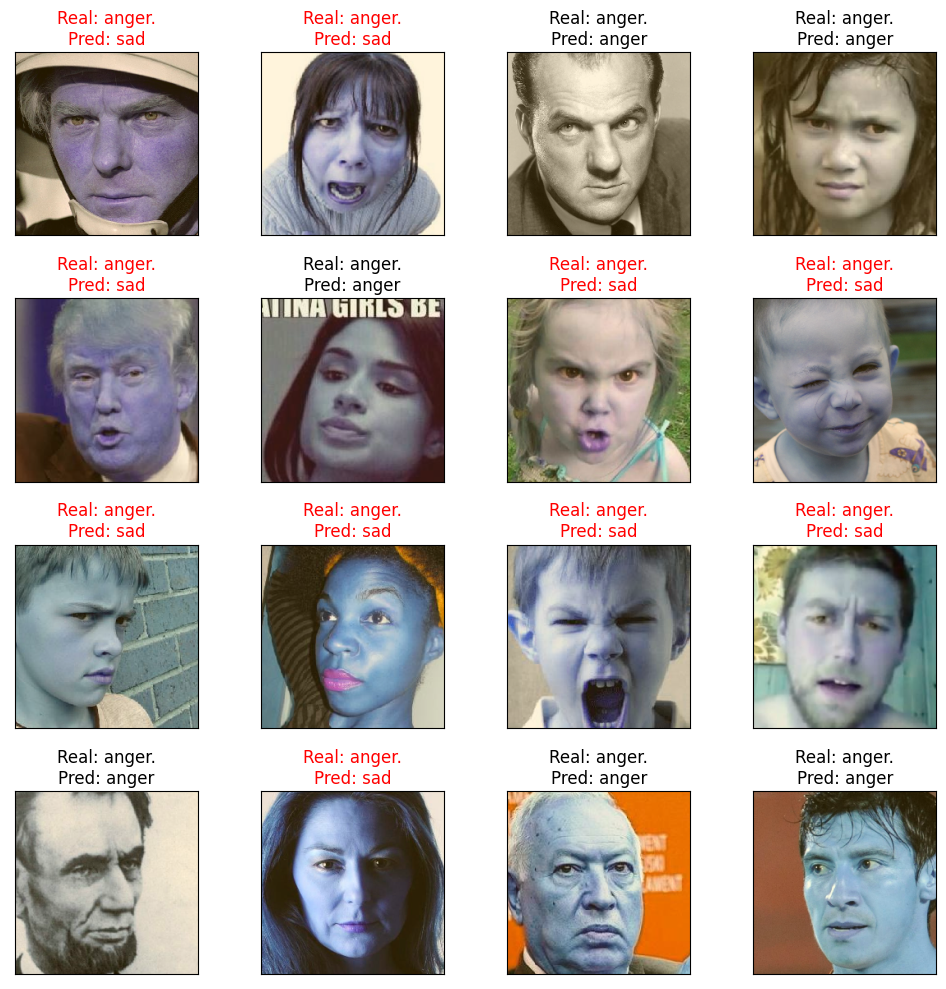

In [ ]:
sample_val_images, sample_val_labels = next(val_data_gen)
show_faces(normalize_0_1(sample_val_images), np.argmax(sample_val_labels, axis = 1), np.argmax(transf_learn_model_6.predict(sample_val_images), axis=1))

In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model_6, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,fear
1,1.jpg,sad
2,2.jpg,sad
3,3.jpg,sad
4,4.jpg,sad
...,...,...
4995,4995.jpg,sad
4996,4996.jpg,uncertain
4997,4997.jpg,sad
4998,4998.jpg,sad


In [ ]:
answer_df.to_csv('answer.csv', index = False)

**0.13 на private kaggle**

# Full VGGFace

**А теперь, как я уже говорил выше, попробуем повторить результат некоего студента для этой сети. Он использовал всю сеть целиком, т.е полностью разморозил все слои. Давайте посмотрим, к чему это приведёт.**

In [ ]:
base_model_6.trainable = True

In [ ]:
base_model_6.summary()

Model: "vggface_resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1/7x7_s2 (Conv2D)          (None, 112, 112, 64  9408        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv1/7x7_s2/bn (BatchNormaliz  (None, 112, 112, 64  256        ['conv1/7x7_s2[0][0]']           
 ation)                         )                                                  

                                                                                                  
 conv2_3_1x1_increase (Conv2D)  (None, 55, 55, 256)  16384       ['activation_8[0][0]']           
                                                                                                  
 conv2_3_1x1_increase/bn (Batch  (None, 55, 55, 256)  1024       ['conv2_3_1x1_increase[0][0]']   
 Normalization)                                                                                   
                                                                                                  
 add_2 (Add)                    (None, 55, 55, 256)  0           ['conv2_3_1x1_increase/bn[0][0]',
                                                                  'activation_6[0][0]']           
                                                                                                  
 activation_9 (Activation)      (None, 55, 55, 256)  0           ['add_2[0][0]']                  
          

 add_5 (Add)                    (None, 28, 28, 512)  0           ['conv3_3_1x1_increase/bn[0][0]',
                                                                  'activation_15[0][0]']          
                                                                                                  
 activation_18 (Activation)     (None, 28, 28, 512)  0           ['add_5[0][0]']                  
                                                                                                  
 conv3_4_1x1_reduce (Conv2D)    (None, 28, 28, 128)  65536       ['activation_18[0][0]']          
                                                                                                  
 conv3_4_1x1_reduce/bn (BatchNo  (None, 28, 28, 128)  512        ['conv3_4_1x1_reduce[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 activatio

                                                                                                  
 activation_27 (Activation)     (None, 14, 14, 1024  0           ['add_8[0][0]']                  
                                )                                                                 
                                                                                                  
 conv4_3_1x1_reduce (Conv2D)    (None, 14, 14, 256)  262144      ['activation_27[0][0]']          
                                                                                                  
 conv4_3_1x1_reduce/bn (BatchNo  (None, 14, 14, 256)  1024       ['conv4_3_1x1_reduce[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 activation_28 (Activation)     (None, 14, 14, 256)  0           ['conv4_3_1x1_reduce/bn[0][0]']  
          

                                                                                                  
 conv4_6_1x1_reduce/bn (BatchNo  (None, 14, 14, 256)  1024       ['conv4_6_1x1_reduce[0][0]']     
 rmalization)                                                                                     
                                                                                                  
 activation_37 (Activation)     (None, 14, 14, 256)  0           ['conv4_6_1x1_reduce/bn[0][0]']  
                                                                                                  
 conv4_6_3x3 (Conv2D)           (None, 14, 14, 256)  589824      ['activation_37[0][0]']          
                                                                                                  
 conv4_6_3x3/bn (BatchNormaliza  (None, 14, 14, 256)  1024       ['conv4_6_3x3[0][0]']            
 tion)                                                                                            
          

 activation_46 (Activation)     (None, 7, 7, 512)    0           ['conv5_3_1x1_reduce/bn[0][0]']  
                                                                                                  
 conv5_3_3x3 (Conv2D)           (None, 7, 7, 512)    2359296     ['activation_46[0][0]']          
                                                                                                  
 conv5_3_3x3/bn (BatchNormaliza  (None, 7, 7, 512)   2048        ['conv5_3_3x3[0][0]']            
 tion)                                                                                            
                                                                                                  
 activation_47 (Activation)     (None, 7, 7, 512)    0           ['conv5_3_3x3/bn[0][0]']         
                                                                                                  
 conv5_3_1x1_increase (Conv2D)  (None, 7, 7, 2048)   1048576     ['activation_47[0][0]']          
          

In [ ]:
fine_tune_model_5 = tf.keras.Sequential([
  base_model_6,
  tf.keras.layers.GlobalAveragePooling2D(),
  tf.keras.layers.Dense(512, activation='relu'),
  tf.keras.layers.Dropout(0.1),
  tf.keras.layers.Dense(N_CLASSES, activation='softmax')
])

lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=5e-4,
    decay_steps=50,
    decay_rate=0.98)
checkpoint = ModelCheckpoint(os.path.join(os.getcwd(), 'CPT', 'fine_tune_model_5', '{epoch:02d}_checkpoint_{val_categorical_accuracy:.3f}'),
                             monitor = 'val_categorical_accuracy',
                             verbose=1,
                             save_best_only=True,
                             save_freq='epoch',
                             mode='max')
es = EarlyStopping(monitor='val_categorical_accuracy', mode='max', verbose=1, patience=10)
fine_tune_model_5.compile(loss=tf.keras.losses.CategoricalCrossentropy(),
              optimizer=tf.keras.optimizers.Adam(learning_rate=lr_schedule),
              metrics=[tf.keras.metrics.CategoricalAccuracy(),
                      tfa.metrics.F1Score(num_classes = 9, average = 'macro', dtype=tf.float32)])

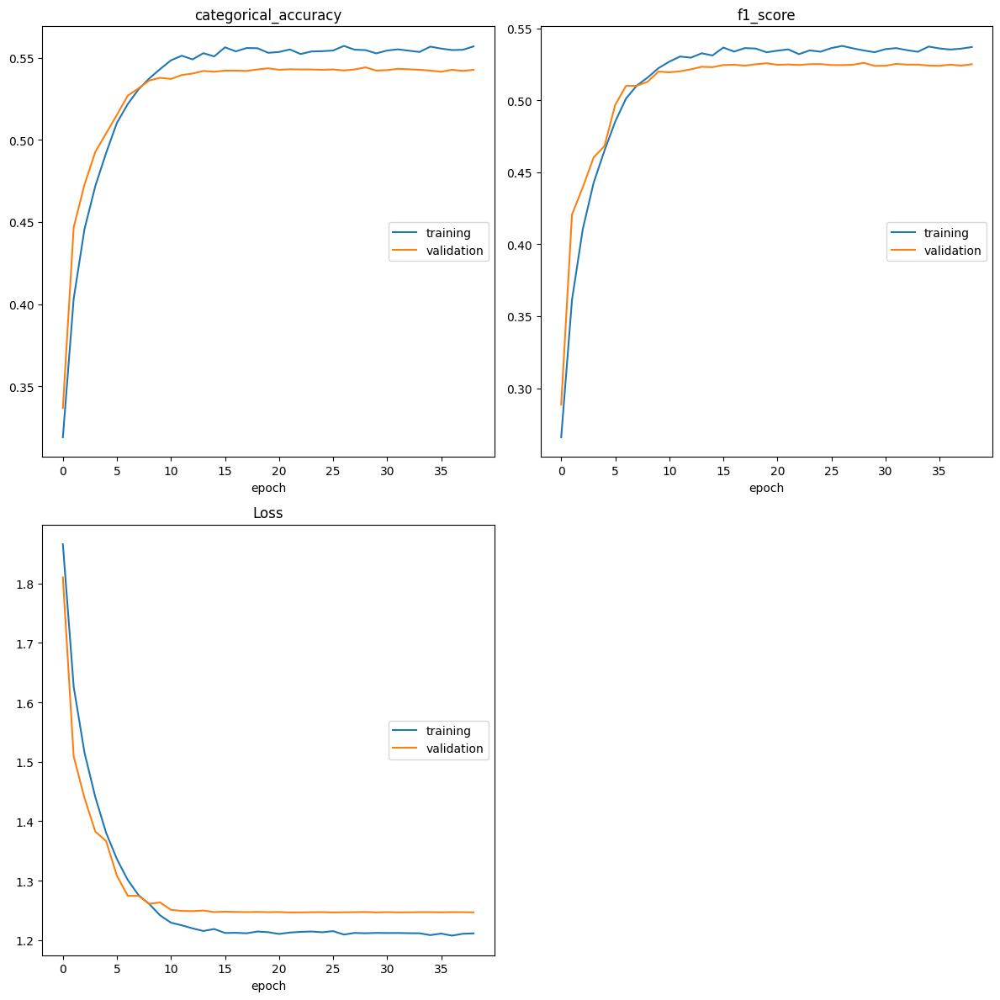

categorical_accuracy
	training         	 (min:    0.319, max:    0.557, cur:    0.557)
	validation       	 (min:    0.337, max:    0.544, cur:    0.543)
f1_score
	training         	 (min:    0.266, max:    0.538, cur:    0.537)
	validation       	 (min:    0.289, max:    0.526, cur:    0.525)
Loss
	training         	 (min:    1.208, max:    1.866, cur:    1.211)
	validation       	 (min:    1.247, max:    1.810, cur:    1.247)
1001/1001 [==============================] - 374s 373ms/step - loss: 1.2114 - categorical_accuracy: 0.5571 - f1_score: 0.5371 - val_loss: 1.2468 - val_categorical_accuracy: 0.5428 - val_f1_score: 0.5251
Epoch 39: early stopping


In [ ]:
EPOCHS = 50
history = fine_tune_model_5.fit(
    train_data_gen,
    epochs=EPOCHS,
    validation_data=val_data_gen,
    callbacks=[es, checkpoint, PlotLossesCallback()])

In [ ]:
fine_tune_model_5 = load_model(os.path.join(os.getcwd(),'CPT', 'fine_tune_model_5', '29_checkpoint_0.544'))

In [ ]:
loss, acc, _ = fine_tune_model_5.evaluate(val_data_gen, verbose=2)
print('Restored model, accuracy: {:5.2f}%'.format(100 * acc))

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


2023-06-04 21:18:46.242848: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8700
2023-06-04 21:18:47.229377: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: No such file or directory
2023-06-04 21:18:47.714289: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:630] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


251/251 - 26s - loss: 1.2474 - categorical_accuracy: 0.5443 - f1_score: 0.5261 - 26s/epoch - 103ms/step
Restored model, accuracy: 54.43%


In [ ]:
answer_df = pd.read_csv('sample_submission.csv')
answer_df['emotion'] = test_df['image_path'].apply(lambda x: one_emotion_predict(transf_learn_model_6, x, IMAGE_SIZE))
answer_df['emotion'] = answer_df['emotion'].apply(lambda x: names[x])

In [ ]:
answer_df

,image_path,emotion
0,0.jpg,surprise
1,1.jpg,surprise
2,2.jpg,surprise
3,3.jpg,surprise
4,4.jpg,surprise
...,...,...
4995,4995.jpg,surprise
4996,4996.jpg,surprise
4997,4997.jpg,surprise
4998,4998.jpg,surprise


In [ ]:
answer_df.to_csv('answer11.csv', index = False)

**0.1304 на private kaggle**

**Как я и ожидал, произошло сильное переобучение сети. Поэтому, несмотря на улучшение метрики на обучающих данных, на private kaggle результат провальный.**

**Сведем результаты всех наших алгоритмов в таблицу. Сюда же добавим результаты наших экспериментов (см соответствующие ноутбуки).**

In [5]:
data = {'Самописная сеть': [0.1736, '-', 0.072, 0.067],
        'ConvNeXtXLarge': [0.4508, 0.4228, 0.205, 0.199],
        'Efficient net V2 Long': [0.3456, 0.4372, 0.197, 0.203],
        'EfficientNetV2B0': [0.3408, 0.3576, 0.101, 0.088],
        'Xception': [0.1312, 0.194, 0.091, 0.081],
        'VGG19': [0.2172, '-', 0.083, 0.076],
        'VGGFace': [0.13, 0.1304, 0.085, 0.079],
        'ConvNeXtXLarge w/o uncertain': [0.442, 0.428, '-', '-'],
        'ordered ConvNeXtXLarge': [0.406, '-', 0.192, 0.197]
}

pd.DataFrame.from_dict(data, orient='index',
                       columns = ['transfer learning', 'fine tuning', 'mean time', 'median time'])

,transfer learning,fine tuning,mean time,median time
Самописная сеть,0.1736,-,0.072,0.067
ConvNeXtXLarge,0.4508,0.4228,0.205,0.199
Efficient net V2 Long,0.3456,0.4372,0.197,0.203
EfficientNetV2B0,0.3408,0.3576,0.101,0.088
Xception,0.1312,0.194,0.091,0.081
VGG19,0.2172,-,0.083,0.076
VGGFace,0.1300,0.1304,0.085,0.079
ConvNeXtXLarge w/o uncertain,0.4420,0.428,-,-
ordered ConvNeXtXLarge,0.4060,-,0.192,0.197


# Вывод

**На основе всех экспериментов выбираем модель на базе transfer learning сети ConvNeXtXLarge**